In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
from sklearn.decomposition import PCA
from sklearn.feature_selection import mutual_info_regression, SelectPercentile
from sklearn.feature_selection import RFE
from sklearn.ensemble import RandomForestRegressor

pd.pandas.set_option('display.max_columns', None)

In [2]:
from google.colab import files
uploaded = files.upload()

Saving prosperLoanData.csv to prosperLoanData.csv


In [3]:
dataset = pd.read_csv("prosperLoanData.csv")

In [4]:
dataset.shape

(113937, 81)

In [5]:
dataset.head()

,ListingKey,ListingNumber,ListingCreationDate,CreditGrade,Term,LoanStatus,ClosedDate,BorrowerAPR,BorrowerRate,LenderYield,EstimatedEffectiveYield,EstimatedLoss,EstimatedReturn,ProsperRating (numeric),ProsperRating (Alpha),ProsperScore,ListingCategory (numeric),BorrowerState,Occupation,EmploymentStatus,EmploymentStatusDuration,IsBorrowerHomeowner,CurrentlyInGroup,GroupKey,DateCreditPulled,CreditScoreRangeLower,CreditScoreRangeUpper,FirstRecordedCreditLine,CurrentCreditLines,OpenCreditLines,TotalCreditLinespast7years,OpenRevolvingAccounts,OpenRevolvingMonthlyPayment,InquiriesLast6Months,TotalInquiries,CurrentDelinquencies,AmountDelinquent,DelinquenciesLast7Years,PublicRecordsLast10Years,PublicRecordsLast12Months,RevolvingCreditBalance,BankcardUtilization,AvailableBankcardCredit,TotalTrades,TradesNeverDelinquent (percentage),TradesOpenedLast6Months,DebtToIncomeRatio,IncomeRange,IncomeVerifiable,StatedMonthlyIncome,LoanKey,TotalProsperLoans,TotalProsperPaymentsBilled,OnTimeProsperPayments,ProsperPaymentsLessThanOneMonthLate,ProsperPaymentsOneMonthPlusLate,ProsperPrincipalBorrowed,ProsperPrincipalOutstanding,ScorexChangeAtTimeOfListing,LoanCurrentDaysDelinquent,LoanFirstDefaultedCycleNumber,LoanMonthsSinceOrigination,LoanNumber,LoanOriginalAmount,LoanOriginationDate,LoanOriginationQuarter,MemberKey,MonthlyLoanPayment,LP_CustomerPayments,LP_CustomerPrincipalPayments,LP_InterestandFees,LP_ServiceFees,LP_CollectionFees,LP_GrossPrincipalLoss,LP_NetPrincipalLoss,LP_NonPrincipalRecoverypayments,PercentFunded,Recommendations,InvestmentFromFriendsCount,InvestmentFromFriendsAmount,Investors
0,1021339766868145413AB3B,193129,2007-08-26 19:09:29.263000000,C,36,Completed,2009-08-14 00:00:00,0.16516,0.1580,0.1380,NaN,NaN,NaN,NaN,NaN,NaN,0,CO,Other,Self-employed,2.0,True,True,NaN,2007-08-26 18:41:46.780000000,640.0,659.0,2001-10-11 00:00:00,5.0,4.0,12.0,1,24.0,3.0,3.0,2.0,472.0,4.0,0.0,0.0,0.0,0.00,1500.0,11.0,0.81,0.0,0.17,"$25,000-49,999",True,3083.333333,E33A3400205839220442E84,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN,78,19141,9425,2007-09-12 00:00:00,Q3 2007,1F3E3376408759268057EDA,330.43,11396.14,9425.00,1971.14,-133.18,0.0,0.0,0.0,0.0,1.0,0,0,0.0,258
1,10273602499503308B223C1,1209647,2014-02-27 08:28:07.900000000,NaN,36,Current,NaN,0.12016,0.0920,0.0820,0.07960,0.0249,0.05470,6.0,A,7.0,2,CO,Professional,Employed,44.0,False,False,NaN,2014-02-27 08:28:14,680.0,699.0,1996-03-18 00:00:00,14.0,14.0,29.0,13,389.0,3.0,5.0,0.0,0.0,0.0,1.0,0.0,3989.0,0.21,10266.0,29.0,1.00,2.0,0.18,"$50,000-74,999",True,6125.000000,9E3B37071505919926B1D82,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN,0,134815,10000,2014-03-03 00:00:00,Q1 2014,1D13370546739025387B2F4,318.93,0.00,0.00,0.00,0.00,0.0,0.0,0.0,0.0,1.0,0,0,0.0,1
2,0EE9337825851032864889A,81716,2007-01-05 15:00:47.090000000,HR,36,Completed,2009-12-17 00:00:00,0.28269,0.2750,0.2400,NaN,NaN,NaN,NaN,NaN,NaN,0,GA,Other,Not available,NaN,False,True,783C3371218786870A73D20,2007-01-02 14:09:10.060000000,480.0,499.0,2002-07-27 00:00:00,NaN,NaN,3.0,0,0.0,0.0,1.0,1.0,NaN,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.06,Not displayed,True,2083.333333,6954337960046817851BCB2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN,86,6466,3001,2007-01-17 00:00:00,Q1 2007,5F7033715035555618FA612,123.32,4186.63,3001.00,1185.63,-24.20,0.0,0.0,0.0,0.0,1.0,0,0,0.0,41
3,0EF5356002482715299901A,658116,2012-10-22 11:02:35.010000000,NaN,36,Current,NaN,0.12528,0.0974,0.0874,0.08490,0.0249,0.06000,6.0,A,9.0,16,GA,Skilled Labor,Employed,113.0,True,False,NaN,2012-10-22 11:02:32,800.0,819.0,1983-02-28 00:00:00,5.0,5.0,29.0,7,115.0,0.0,1.0,4.0,10056.0,14.0,0.0,0.0,1444.0,0.04,30754.0,26.0,0.76,0.0,0.15,"$25,000-49,999",True,2875.000000,A0393664465886295619C51,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN,16,77296,10000,2012-11-01 00:00:00,Q4 2012,9ADE356069835475068C6D2,321.45,5143.20,4091.09,1052.11,-108.01,0.0,0.0,0.0,0.0,1.0,0,0,0.0,158
4,0F023589499656230C5E3E2,909464,2013-09-14 18:38:39.097000000,NaN,36,Current,NaN,0.24614,0.2085,0.1985,0.18316,0.0925,0.09066,3.0,D,4.0,2,MN

In [6]:
dataset['LoanStatus']

,LoanStatus
0,Completed
1,Current
2,Completed
3,Current
4,Current
...,...
113932,Current
113933,FinalPaymentInProgress
113934,Current
113935,Completed


In [7]:
# Checking for duplicates

dataset.duplicated().any()

False

In [8]:
dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 113937 entries, 0 to 113936
Data columns (total 81 columns):
 #   Column                               Non-Null Count   Dtype  
---  ------                               --------------   -----  
 0   ListingKey                           113937 non-null  object 
 1   ListingNumber                        113937 non-null  int64  
 2   ListingCreationDate                  113937 non-null  object 
 3   CreditGrade                          28953 non-null   object 
 4   Term                                 113937 non-null  int64  
 5   LoanStatus                           113937 non-null  object 
 6   ClosedDate                           55089 non-null   object 
 7   BorrowerAPR                          113912 non-null  float64
 8   BorrowerRate                         113937 non-null  float64
 9   LenderYield                          113937 non-null  float64
 10  EstimatedEffectiveYield              84853 non-null   float64
 11  EstimatedLoss

In [9]:
# Dataset statistics

dataset.describe()

,ListingNumber,Term,BorrowerAPR,BorrowerRate,LenderYield,EstimatedEffectiveYield,EstimatedLoss,EstimatedReturn,ProsperRating (numeric),ProsperScore,ListingCategory (numeric),EmploymentStatusDuration,CreditScoreRangeLower,CreditScoreRangeUpper,CurrentCreditLines,OpenCreditLines,TotalCreditLinespast7years,OpenRevolvingAccounts,OpenRevolvingMonthlyPayment,InquiriesLast6Months,TotalInquiries,CurrentDelinquencies,AmountDelinquent,DelinquenciesLast7Years,PublicRecordsLast10Years,PublicRecordsLast12Months,RevolvingCreditBalance,BankcardUtilization,AvailableBankcardCredit,TotalTrades,TradesNeverDelinquent (percentage),TradesOpenedLast6Months,DebtToIncomeRatio,StatedMonthlyIncome,TotalProsperLoans,TotalProsperPaymentsBilled,OnTimeProsperPayments,ProsperPaymentsLessThanOneMonthLate,ProsperPaymentsOneMonthPlusLate,ProsperPrincipalBorrowed,ProsperPrincipalOutstanding,ScorexChangeAtTimeOfListing,LoanCurrentDaysDelinquent,LoanFirstDefaultedCycleNumber,LoanMonthsSinceOrigination,LoanNumber,LoanOriginalAmount,MonthlyLoanPayment,LP_CustomerPayments,LP_CustomerPrincipalPayments,LP_InterestandFees,LP_ServiceFees,LP_CollectionFees,LP_GrossPrincipalLoss,LP_NetPrincipalLoss,LP_NonPrincipalRecoverypayments,PercentFunded,Recommendations,InvestmentFromFriendsCount,InvestmentFromFriendsAmount,Investors
count,1.139370e+05,113937.000000,113912.000000,113937.000000,113937.000000,84853.000000,84853.000000,84853.000000,84853.000000,84853.000000,113937.000000,106312.000000,113346.000000,113346.000000,106333.000000,106333.000000,113240.000000,113937.00000,113937.000000,113240.000000,112778.000000,113240.000000,106315.000000,112947.000000,113240.000000,106333.000000,1.063330e+05,106333.000000,106393.000000,106393.000000,106393.000000,106393.000000,105383.000000,1.139370e+05,22085.000000,22085.000000,22085.000000,22085.000000,22085.000000,22085.000000,22085.000000,18928.000000,113937.000000,16952.000000,113937.000000,113937.000000,113937.00000,113937.000000,113937.000000,113937.000000,113937.000000,113937.000000,113937.000000,113937.000000,113937.000000,113937.000000,113937.000000,113937.000000,113937.000000,113937.000000,113937.000000
mean,6.278857e+05,40.830248,0.218828,0.192764,0.182701,0.168661,0.080306,0.096068,4.072243,5.950067,2.774209,96.071582,685.567731,704.567731,10.317192,9.260164,26.754539,6.96979,398.292161,1.435085,5.584405,0.592052,984.507059,4.154984,0.312646,0.015094,1.759871e+04,0.561309,11210.225447,23.230034,0.885897,0.802327,0.275947,5.608026e+03,1.421100,22.934345,22.271949,0.613629,0.048540,8472.311961,2930.313906,-3.223214,152.816539,16.268464,31.896882,69444.474271,8337.01385,272.475783,4183.079489,3105.536588,1077.542901,-54.725641,-14.242698,700.446342,681.420499,25.142686,0.998584,0.048027,0.023460,16.550751,80.475228
std,3.280762e+05,10.436212,0.080364,0.074818,0.074516,0.068467,0.046764,0.030403,1.673227,2.376501,3.996797,94.480605,66.458275,66.458275,5.457866,5.022644,13.637871,4.63097,447.159711,2.437507,6.429946,1.978707,7158.270157,10.160216,0.727868,0.154092,3.293640e+04,0.317918,19818.361309,11.871311,0.148179,1.097637,0.551759,7.478497e+03,0.764042,19.249584,18.830425,2.446827,0.556285,7395.507650,3806.635075,50.063567,466.320254,9.005898,29.974184,38930.479610,6245.80058,192.697812,4790.907234,4069.527670,1183.414168,60.675425,109.232758,2388.513831,2357.167068,275.657937,0.017919,0.332353,0.232412,294.545422,103.239020
min,4.000000e+00,12.000000,0.006530,0.000000,-0.010000,-0.182700,0.004900,-0.182700,1.000000,1.000000,0.000000,0.000000,0.000000,19.000000,0.000000,0.000000,2.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000e+00,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000e+00,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-209.000000,0.000000,0.000000,0.000000,1.000000,1000.00000,0.000000,-2.349900,0.000000,-2.349900,-664.870000,-9274.750000,-94.200000,-954.550000,0.000000,0.700000,0.000000,0.000000,0.000000,1.000000
25%,4.009190e+05,36.000000

**Missing values**

In [10]:
dataset.isnull().sum()

,0
ListingKey,0
ListingNumber,0
ListingCreationDate,0
CreditGrade,84984
Term,0
...,...
PercentFunded,0
Recommendations,0
InvestmentFromFriendsCount,0
InvestmentFromFriendsAmount,0


In [11]:
# Displaying all the features that has missing values.

null_columns = dataset.columns[dataset.isnull().any()]
print(null_columns)

Index(['CreditGrade', 'ClosedDate', 'BorrowerAPR', 'EstimatedEffectiveYield',
       'EstimatedLoss', 'EstimatedReturn', 'ProsperRating (numeric)',
       'ProsperRating (Alpha)', 'ProsperScore', 'BorrowerState', 'Occupation',
       'EmploymentStatus', 'EmploymentStatusDuration', 'GroupKey',
       'CreditScoreRangeLower', 'CreditScoreRangeUpper',
       'FirstRecordedCreditLine', 'CurrentCreditLines', 'OpenCreditLines',
       'TotalCreditLinespast7years', 'InquiriesLast6Months', 'TotalInquiries',
       'CurrentDelinquencies', 'AmountDelinquent', 'DelinquenciesLast7Years',
       'PublicRecordsLast10Years', 'PublicRecordsLast12Months',
       'RevolvingCreditBalance', 'BankcardUtilization',
       'AvailableBankcardCredit', 'TotalTrades',
       'TradesNeverDelinquent (percentage)', 'TradesOpenedLast6Months',
       'DebtToIncomeRatio', 'TotalProsperLoans', 'TotalProsperPaymentsBilled',
       'OnTimeProsperPayments', 'ProsperPaymentsLessThanOneMonthLate',
       'ProsperPaymentsOne

In [12]:
print(len(null_columns))

43


43 columns contains null values.

In [13]:
# Percentage of missing values present.

features_with_na = [features for features in dataset.columns if dataset[features].isnull().sum()>1]

for feature in features_with_na:
    print(feature, np.round(dataset[feature].isnull().mean(), 4),  ' % missing values')

CreditGrade 0.7459  % missing values
ClosedDate 0.5165  % missing values
BorrowerAPR 0.0002  % missing values
EstimatedEffectiveYield 0.2553  % missing values
EstimatedLoss 0.2553  % missing values
EstimatedReturn 0.2553  % missing values
ProsperRating (numeric) 0.2553  % missing values
ProsperRating (Alpha) 0.2553  % missing values
ProsperScore 0.2553  % missing values
BorrowerState 0.0484  % missing values
Occupation 0.0315  % missing values
EmploymentStatus 0.0198  % missing values
EmploymentStatusDuration 0.0669  % missing values
GroupKey 0.8829  % missing values
CreditScoreRangeLower 0.0052  % missing values
CreditScoreRangeUpper 0.0052  % missing values
FirstRecordedCreditLine 0.0061  % missing values
CurrentCreditLines 0.0667  % missing values
OpenCreditLines 0.0667  % missing values
TotalCreditLinespast7years 0.0061  % missing values
InquiriesLast6Months 0.0061  % missing values
TotalInquiries 0.0102  % missing values
CurrentDelinquencies 0.0061  % missing values
AmountDelinque

Removing the features that has more than 80% null values.

In [14]:
# Calculate the percentage of missing values for each column
null_percentage = dataset.isnull().mean() * 100

# Filter columns that have less than 80% missing values
data = dataset.loc[:, null_percentage < 80]

In [15]:
data.head()

,ListingKey,ListingNumber,ListingCreationDate,CreditGrade,Term,LoanStatus,ClosedDate,BorrowerAPR,BorrowerRate,LenderYield,EstimatedEffectiveYield,EstimatedLoss,EstimatedReturn,ProsperRating (numeric),ProsperRating (Alpha),ProsperScore,ListingCategory (numeric),BorrowerState,Occupation,EmploymentStatus,EmploymentStatusDuration,IsBorrowerHomeowner,CurrentlyInGroup,DateCreditPulled,CreditScoreRangeLower,CreditScoreRangeUpper,FirstRecordedCreditLine,CurrentCreditLines,OpenCreditLines,TotalCreditLinespast7years,OpenRevolvingAccounts,OpenRevolvingMonthlyPayment,InquiriesLast6Months,TotalInquiries,CurrentDelinquencies,AmountDelinquent,DelinquenciesLast7Years,PublicRecordsLast10Years,PublicRecordsLast12Months,RevolvingCreditBalance,BankcardUtilization,AvailableBankcardCredit,TotalTrades,TradesNeverDelinquent (percentage),TradesOpenedLast6Months,DebtToIncomeRatio,IncomeRange,IncomeVerifiable,StatedMonthlyIncome,LoanKey,LoanCurrentDaysDelinquent,LoanMonthsSinceOrigination,LoanNumber,LoanOriginalAmount,LoanOriginationDate,LoanOriginationQuarter,MemberKey,MonthlyLoanPayment,LP_CustomerPayments,LP_CustomerPrincipalPayments,LP_InterestandFees,LP_ServiceFees,LP_CollectionFees,LP_GrossPrincipalLoss,LP_NetPrincipalLoss,LP_NonPrincipalRecoverypayments,PercentFunded,Recommendations,InvestmentFromFriendsCount,InvestmentFromFriendsAmount,Investors
0,1021339766868145413AB3B,193129,2007-08-26 19:09:29.263000000,C,36,Completed,2009-08-14 00:00:00,0.16516,0.1580,0.1380,NaN,NaN,NaN,NaN,NaN,NaN,0,CO,Other,Self-employed,2.0,True,True,2007-08-26 18:41:46.780000000,640.0,659.0,2001-10-11 00:00:00,5.0,4.0,12.0,1,24.0,3.0,3.0,2.0,472.0,4.0,0.0,0.0,0.0,0.00,1500.0,11.0,0.81,0.0,0.17,"$25,000-49,999",True,3083.333333,E33A3400205839220442E84,0,78,19141,9425,2007-09-12 00:00:00,Q3 2007,1F3E3376408759268057EDA,330.43,11396.14,9425.00,1971.14,-133.18,0.0,0.0,0.0,0.0,1.0,0,0,0.0,258
1,10273602499503308B223C1,1209647,2014-02-27 08:28:07.900000000,NaN,36,Current,NaN,0.12016,0.0920,0.0820,0.07960,0.0249,0.05470,6.0,A,7.0,2,CO,Professional,Employed,44.0,False,False,2014-02-27 08:28:14,680.0,699.0,1996-03-18 00:00:00,14.0,14.0,29.0,13,389.0,3.0,5.0,0.0,0.0,0.0,1.0,0.0,3989.0,0.21,10266.0,29.0,1.00,2.0,0.18,"$50,000-74,999",True,6125.000000,9E3B37071505919926B1D82,0,0,134815,10000,2014-03-03 00:00:00,Q1 2014,1D13370546739025387B2F4,318.93,0.00,0.00,0.00,0.00,0.0,0.0,0.0,0.0,1.0,0,0,0.0,1
2,0EE9337825851032864889A,81716,2007-01-05 15:00:47.090000000,HR,36,Completed,2009-12-17 00:00:00,0.28269,0.2750,0.2400,NaN,NaN,NaN,NaN,NaN,NaN,0,GA,Other,Not available,NaN,False,True,2007-01-02 14:09:10.060000000,480.0,499.0,2002-07-27 00:00:00,NaN,NaN,3.0,0,0.0,0.0,1.0,1.0,NaN,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.06,Not displayed,True,2083.333333,6954337960046817851BCB2,0,86,6466,3001,2007-01-17 00:00:00,Q1 2007,5F7033715035555618FA612,123.32,4186.63,3001.00,1185.63,-24.20,0.0,0.0,0.0,0.0,1.0,0,0,0.0,41
3,0EF5356002482715299901A,658116,2012-10-22 11:02:35.010000000,NaN,36,Current,NaN,0.12528,0.0974,0.0874,0.08490,0.0249,0.06000,6.0,A,9.0,16,GA,Skilled Labor,Employed,113.0,True,False,2012-10-22 11:02:32,800.0,819.0,1983-02-28 00:00:00,5.0,5.0,29.0,7,115.0,0.0,1.0,4.0,10056.0,14.0,0.0,0.0,1444.0,0.04,30754.0,26.0,0.76,0.0,0.15,"$25,000-49,999",True,2875.000000,A0393664465886295619C51,0,16,77296,10000,2012-11-01 00:00:00,Q4 2012,9ADE356069835475068C6D2,321.45,5143.20,4091.09,1052.11,-108.01,0.0,0.0,0.0,0.0,1.0,0,0,0.0,158
4,0F023589499656230C5E3E2,909464,2013-09-14 18:38:39.097000000,NaN,36,Current,NaN,0.24614,0.2085,0.1985,0.18316,0.0925,0.09066,3.0,D,4.0,2,MN,Executive,Employed,44.0,True,False,2013-09-14 18:38:44,680.0,699.0,2004-02-20 00:00:00,19.0,19.0,49.0,6,220.0,1.0,9.0,0.0,0.0,0.0,0.0,0.0,6193.0,0.81,695.0,39.0,0.95,2.0,0.26,"$100,000+",True,9583.333333,A180369302188889200689E,0,6,102670,15000,2013-09-20 00:00:00,Q3 2013,36CE356043264555721F06C,563.97,2819.85,1563.22,1256.63,-60.27,0.0,0.0,0.0,0.0,1.0,0,0,0.0,20


In [16]:
data.shape

(113937, 71)

**Displaying the percentage of missing values.**

In [17]:
features_with_na = [features for features in data.columns if data[features].isnull().sum()>1]

for feature in features_with_na:
    print(feature, np.round(data[feature].isnull().mean(), 4),  ' % missing values')

CreditGrade 0.7459  % missing values
ClosedDate 0.5165  % missing values
BorrowerAPR 0.0002  % missing values
EstimatedEffectiveYield 0.2553  % missing values
EstimatedLoss 0.2553  % missing values
EstimatedReturn 0.2553  % missing values
ProsperRating (numeric) 0.2553  % missing values
ProsperRating (Alpha) 0.2553  % missing values
ProsperScore 0.2553  % missing values
BorrowerState 0.0484  % missing values
Occupation 0.0315  % missing values
EmploymentStatus 0.0198  % missing values
EmploymentStatusDuration 0.0669  % missing values
CreditScoreRangeLower 0.0052  % missing values
CreditScoreRangeUpper 0.0052  % missing values
FirstRecordedCreditLine 0.0061  % missing values
CurrentCreditLines 0.0667  % missing values
OpenCreditLines 0.0667  % missing values
TotalCreditLinespast7years 0.0061  % missing values
InquiriesLast6Months 0.0061  % missing values
TotalInquiries 0.0102  % missing values
CurrentDelinquencies 0.0061  % missing values
AmountDelinquent 0.0669  % missing values
Delinq

# Handling missing values in categorical variables.

Replacing all the missing values in the categorical features with new label called 'Missing'.

In [18]:
# Get all the categorical features from the missing features (features_with_na).

cat_features_nan = [feature for feature in features_with_na if data[feature].dtypes=='object']

print(cat_features_nan)

['CreditGrade', 'ClosedDate', 'ProsperRating (Alpha)', 'BorrowerState', 'Occupation', 'EmploymentStatus', 'FirstRecordedCreditLine']


In [19]:
## Replace missing values with a new label
def replace_cat_feature(data, cat_features_nan):
    data_new = data.copy()
    data_new[cat_features_nan] = data_new[cat_features_nan].fillna('Missing')
    return data_new

In [20]:
data = replace_cat_feature(data, cat_features_nan)

data[cat_features_nan].isnull().sum()

,0
CreditGrade,0
ClosedDate,0
ProsperRating (Alpha),0
BorrowerState,0
Occupation,0
EmploymentStatus,0
FirstRecordedCreditLine,0


# Handling missing values in Numerical features.

In [21]:
# Get all the numerical features from the missing features (features_with_na).

num_features_nan = [feature for feature in features_with_na if data[feature].dtypes != 'object']

print(num_features_nan)

['BorrowerAPR', 'EstimatedEffectiveYield', 'EstimatedLoss', 'EstimatedReturn', 'ProsperRating (numeric)', 'ProsperScore', 'EmploymentStatusDuration', 'CreditScoreRangeLower', 'CreditScoreRangeUpper', 'CurrentCreditLines', 'OpenCreditLines', 'TotalCreditLinespast7years', 'InquiriesLast6Months', 'TotalInquiries', 'CurrentDelinquencies', 'AmountDelinquent', 'DelinquenciesLast7Years', 'PublicRecordsLast10Years', 'PublicRecordsLast12Months', 'RevolvingCreditBalance', 'BankcardUtilization', 'AvailableBankcardCredit', 'TotalTrades', 'TradesNeverDelinquent (percentage)', 'TradesOpenedLast6Months', 'DebtToIncomeRatio']


In [22]:
for feature in num_features_nan:
    print(feature, np.round(data[feature].isnull().mean(), 4),  ' % missing values')

BorrowerAPR 0.0002  % missing values
EstimatedEffectiveYield 0.2553  % missing values
EstimatedLoss 0.2553  % missing values
EstimatedReturn 0.2553  % missing values
ProsperRating (numeric) 0.2553  % missing values
ProsperScore 0.2553  % missing values
EmploymentStatusDuration 0.0669  % missing values
CreditScoreRangeLower 0.0052  % missing values
CreditScoreRangeUpper 0.0052  % missing values
CurrentCreditLines 0.0667  % missing values
OpenCreditLines 0.0667  % missing values
TotalCreditLinespast7years 0.0061  % missing values
InquiriesLast6Months 0.0061  % missing values
TotalInquiries 0.0102  % missing values
CurrentDelinquencies 0.0061  % missing values
AmountDelinquent 0.0669  % missing values
DelinquenciesLast7Years 0.0087  % missing values
PublicRecordsLast10Years 0.0061  % missing values
PublicRecordsLast12Months 0.0667  % missing values
RevolvingCreditBalance 0.0667  % missing values
BankcardUtilization 0.0667  % missing values
AvailableBankcardCredit 0.0662  % missing values


Finding out if the above numerical features containing missing values has outliers.

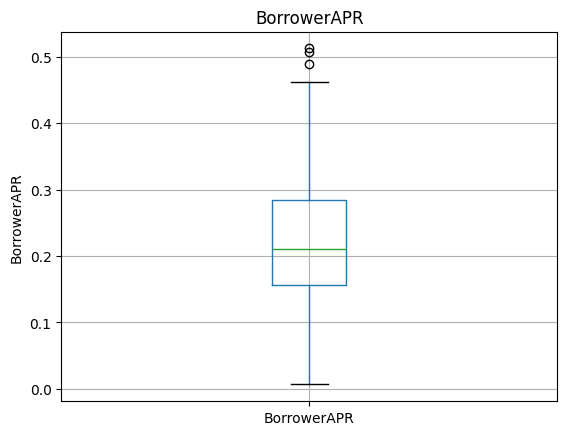

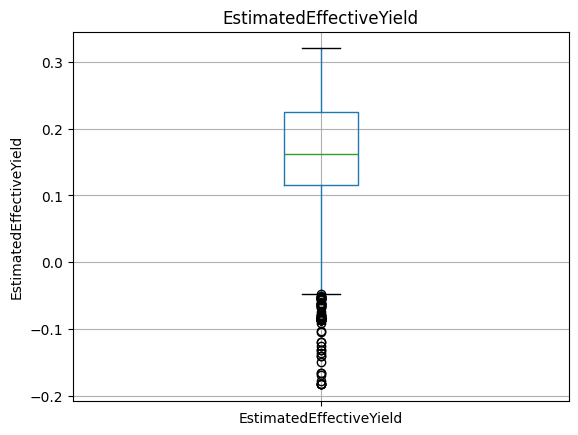

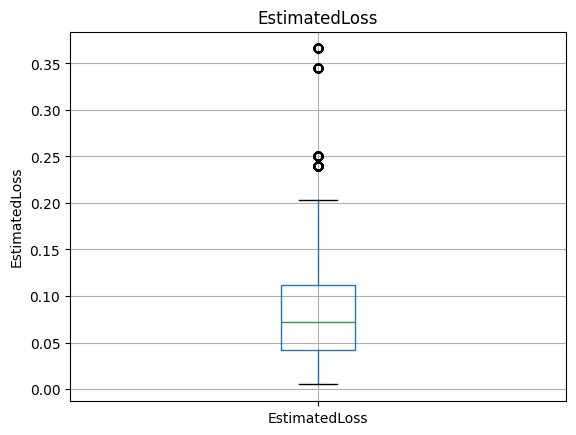

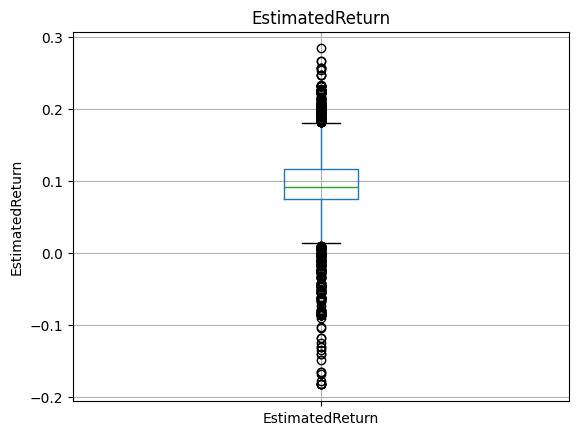

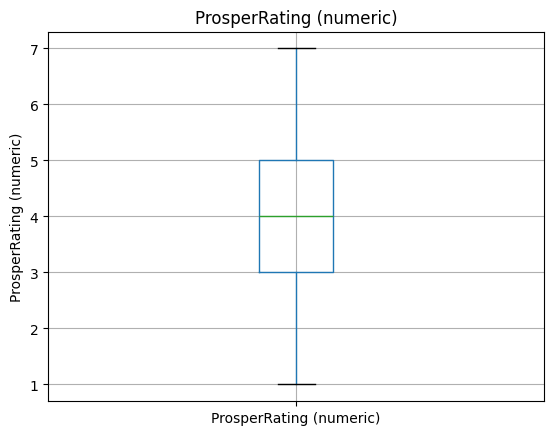

...

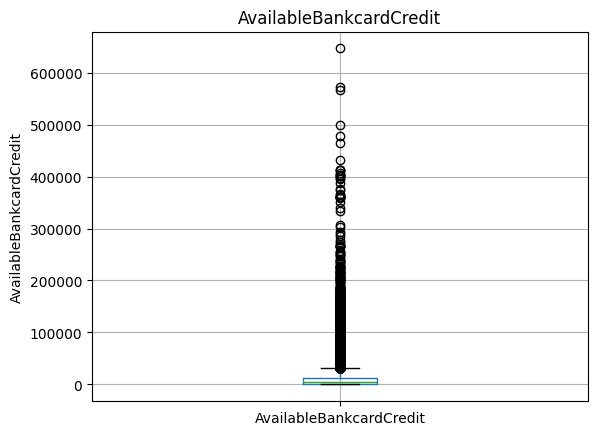

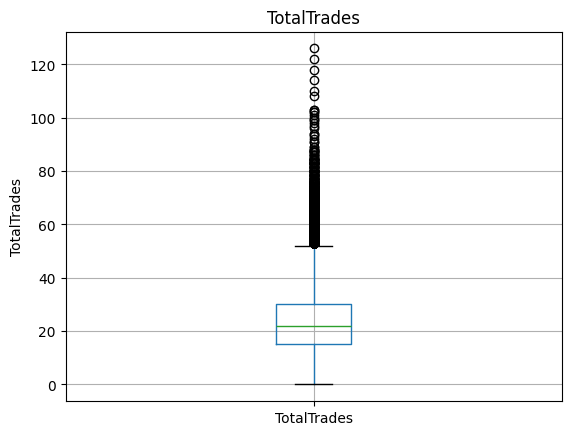

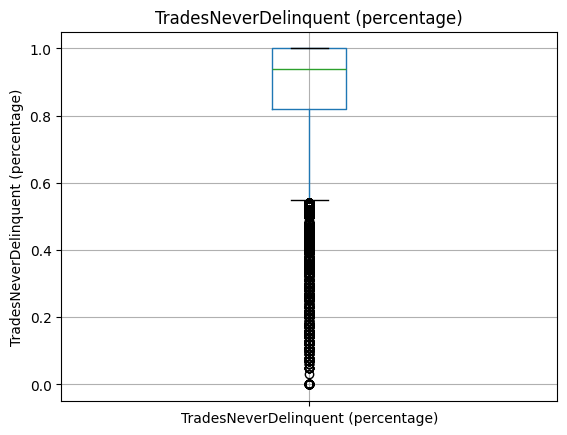

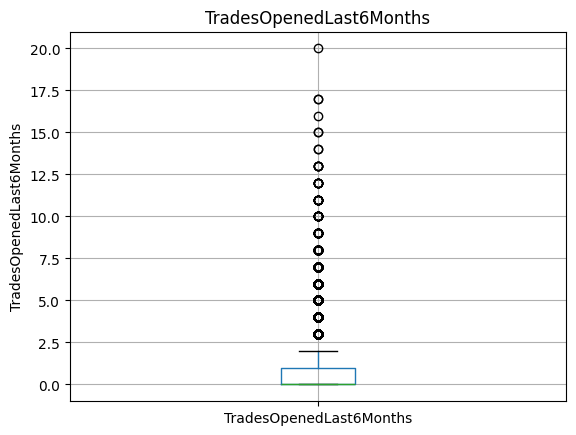

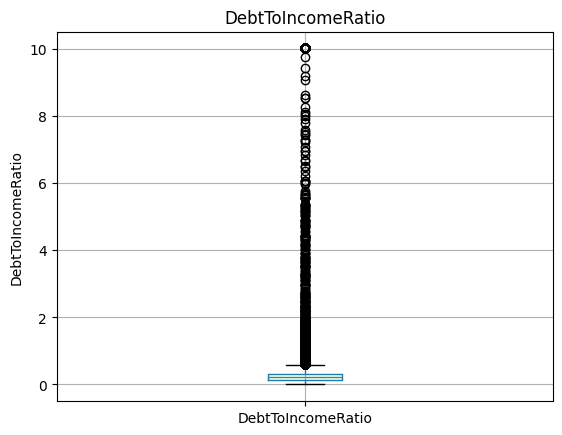

In [23]:
for feature in num_features_nan:
    data.boxplot(column=feature)
    plt.ylabel(feature)
    plt.title(feature)
    plt.show()

# Almost all the numerical features containing null values has outliers. So, replacing all null values with median.

In [24]:
# Replacing missing values of the numerical features with median.

for feature in num_features_nan:
    ## Replacing missing values by using median since there are outliers
    median_value = data[feature].median()
    data[feature].fillna(median_value, inplace=True)

<ipython-input-24-ae7c3e781cd3>:6: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  data[feature].fillna(median_value, inplace=True)


In [25]:
data[num_features_nan].isnull().sum()

,0
BorrowerAPR,0
EstimatedEffectiveYield,0
EstimatedLoss,0
EstimatedReturn,0
ProsperRating (numeric),0
ProsperScore,0
EmploymentStatusDuration,0
CreditScoreRangeLower,0
CreditScoreRangeUpper,0
CurrentCreditLines,0


In [26]:
data.isnull().sum()

,0
ListingKey,0
ListingNumber,0
ListingCreationDate,0
CreditGrade,0
Term,0
...,...
PercentFunded,0
Recommendations,0
InvestmentFromFriendsCount,0
InvestmentFromFriendsAmount,0


In [27]:
data.shape

(113937, 71)

**All the null values has been removed.**

In [28]:
data.head()

,ListingKey,ListingNumber,ListingCreationDate,CreditGrade,Term,LoanStatus,ClosedDate,BorrowerAPR,BorrowerRate,LenderYield,EstimatedEffectiveYield,EstimatedLoss,EstimatedReturn,ProsperRating (numeric),ProsperRating (Alpha),ProsperScore,ListingCategory (numeric),BorrowerState,Occupation,EmploymentStatus,EmploymentStatusDuration,IsBorrowerHomeowner,CurrentlyInGroup,DateCreditPulled,CreditScoreRangeLower,CreditScoreRangeUpper,FirstRecordedCreditLine,CurrentCreditLines,OpenCreditLines,TotalCreditLinespast7years,OpenRevolvingAccounts,OpenRevolvingMonthlyPayment,InquiriesLast6Months,TotalInquiries,CurrentDelinquencies,AmountDelinquent,DelinquenciesLast7Years,PublicRecordsLast10Years,PublicRecordsLast12Months,RevolvingCreditBalance,BankcardUtilization,AvailableBankcardCredit,TotalTrades,TradesNeverDelinquent (percentage),TradesOpenedLast6Months,DebtToIncomeRatio,IncomeRange,IncomeVerifiable,StatedMonthlyIncome,LoanKey,LoanCurrentDaysDelinquent,LoanMonthsSinceOrigination,LoanNumber,LoanOriginalAmount,LoanOriginationDate,LoanOriginationQuarter,MemberKey,MonthlyLoanPayment,LP_CustomerPayments,LP_CustomerPrincipalPayments,LP_InterestandFees,LP_ServiceFees,LP_CollectionFees,LP_GrossPrincipalLoss,LP_NetPrincipalLoss,LP_NonPrincipalRecoverypayments,PercentFunded,Recommendations,InvestmentFromFriendsCount,InvestmentFromFriendsAmount,Investors
0,1021339766868145413AB3B,193129,2007-08-26 19:09:29.263000000,C,36,Completed,2009-08-14 00:00:00,0.16516,0.1580,0.1380,0.16150,0.0724,0.09170,4.0,Missing,6.0,0,CO,Other,Self-employed,2.0,True,True,2007-08-26 18:41:46.780000000,640.0,659.0,2001-10-11 00:00:00,5.0,4.0,12.0,1,24.0,3.0,3.0,2.0,472.0,4.0,0.0,0.0,0.0,0.00,1500.0,11.0,0.81,0.0,0.17,"$25,000-49,999",True,3083.333333,E33A3400205839220442E84,0,78,19141,9425,2007-09-12 00:00:00,Q3 2007,1F3E3376408759268057EDA,330.43,11396.14,9425.00,1971.14,-133.18,0.0,0.0,0.0,0.0,1.0,0,0,0.0,258
1,10273602499503308B223C1,1209647,2014-02-27 08:28:07.900000000,Missing,36,Current,Missing,0.12016,0.0920,0.0820,0.07960,0.0249,0.05470,6.0,A,7.0,2,CO,Professional,Employed,44.0,False,False,2014-02-27 08:28:14,680.0,699.0,1996-03-18 00:00:00,14.0,14.0,29.0,13,389.0,3.0,5.0,0.0,0.0,0.0,1.0,0.0,3989.0,0.21,10266.0,29.0,1.00,2.0,0.18,"$50,000-74,999",True,6125.000000,9E3B37071505919926B1D82,0,0,134815,10000,2014-03-03 00:00:00,Q1 2014,1D13370546739025387B2F4,318.93,0.00,0.00,0.00,0.00,0.0,0.0,0.0,0.0,1.0,0,0,0.0,1
2,0EE9337825851032864889A,81716,2007-01-05 15:00:47.090000000,HR,36,Completed,2009-12-17 00:00:00,0.28269,0.2750,0.2400,0.16150,0.0724,0.09170,4.0,Missing,6.0,0,GA,Other,Not available,67.0,False,True,2007-01-02 14:09:10.060000000,480.0,499.0,2002-07-27 00:00:00,10.0,9.0,3.0,0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,8549.0,0.60,4100.0,22.0,0.94,0.0,0.06,Not displayed,True,2083.333333,6954337960046817851BCB2,0,86,6466,3001,2007-01-17 00:00:00,Q1 2007,5F7033715035555618FA612,123.32,4186.63,3001.00,1185.63,-24.20,0.0,0.0,0.0,0.0,1.0,0,0,0.0,41
3,0EF5356002482715299901A,658116,2012-10-22 11:02:35.010000000,Missing,36,Current,Missing,0.12528,0.0974,0.0874,0.08490,0.0249,0.06000,6.0,A,9.0,16,GA,Skilled Labor,Employed,113.0,True,False,2012-10-22 11:02:32,800.0,819.0,1983-02-28 00:00:00,5.0,5.0,29.0,7,115.0,0.0,1.0,4.0,10056.0,14.0,0.0,0.0,1444.0,0.04,30754.0,26.0,0.76,0.0,0.15,"$25,000-49,999",True,2875.000000,A0393664465886295619C51,0,16,77296,10000,2012-11-01 00:00:00,Q4 2012,9ADE356069835475068C6D2,321.45,5143.20,4091.09,1052.11,-108.01,0.0,0.0,0.0,0.0,1.0,0,0,0.0,158
4,0F023589499656230C5E3E2,909464,2013-09-14 18:38:39.097000000,Missing,36,Current,Missing,0.24614,0.2085,0.1985,0.18316,0.0925,0.09066,3.0,D,4.0,2,MN,Executive,Employed,44.0,True,False,2013-09-14 18:38:44,680.0,699.0,2004-02-20 00:00:00,19.0,19.0,49.0,6,220.0,1.0,9.0,0.0,0.0,0.0,0.0,0.0,6193.0,0.81,695.0,39.0,0.95,2.0,0.26,"$100,000+",True,9583.333333,A180369302188889200689E,0,6,102670,15000,2013-09-20 00:00:00,Q3 2013,36CE356043264555721F06C,563.97,2819.85,1563.22,1256.63,-60.27,0.0,0.0,0.0,0.0,1.0,0,0,0.0,20


**Distribution of LoanStatus variable**

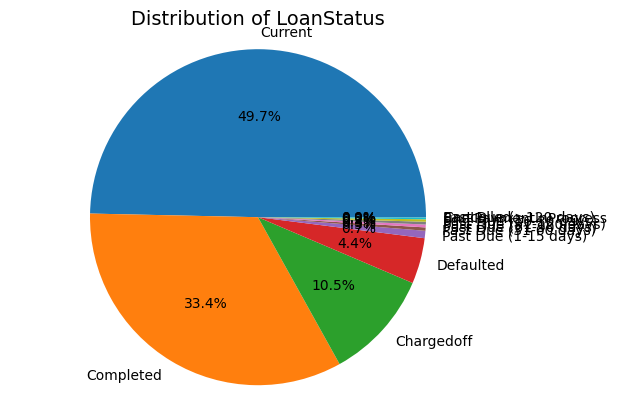

In [29]:
# Pie-chart

target = data['LoanStatus'].value_counts()

fig1, ax1 = plt.subplots()

ax1.pie(target, labels=target.index, autopct='%1.1f%%', shadow=None)
ax1.axis('equal')
plt.title("Distribution of LoanStatus", fontsize=14)
plt.show()

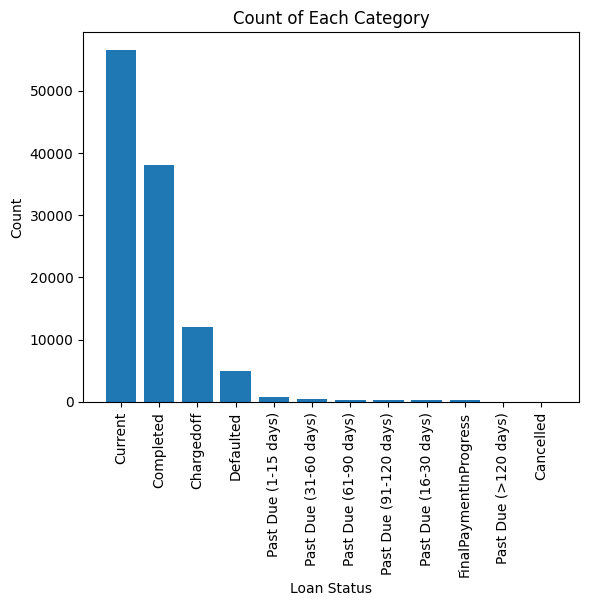

In [30]:
# Bar plot

# Get the count of unique values in the 'Category' column
target = data['LoanStatus'].value_counts()

# Create the bar plot
plt.bar(target.index, target.values)

# Adding title and labels
plt.title('Count of Each Category')
plt.xlabel('Loan Status')
plt.ylabel('Count')

plt.xticks(rotation=90)

# Show the plot
plt.show()

In [31]:
# Counts of each category in LoanStatus.

loan_status_counts = data['LoanStatus'].value_counts()

loan_status_df = pd.DataFrame({
    'Loan Status': loan_status_counts.index,
    'Counts': loan_status_counts.values
})

loan_status_df

,Loan Status,Counts
0,Current,56576
1,Completed,38074
2,Chargedoff,11992
3,Defaulted,5018
4,Past Due (1-15 days),806
5,Past Due (31-60 days),363
6,Past Due (61-90 days),313
7,Past Due (91-120 days),304
8,Past Due (16-30 days),265
9,FinalPaymentInProgress,205


The features "ListingKey", "ListingNumber", "LoanKey", "LoanNumber" and "MemberKey" are all unique keys which doesn't provide significant contribution to the analysis. So, it must be removed.

In [32]:
data = data.drop(['ListingKey', 'ListingNumber', 'LoanKey', 'LoanNumber', 'MemberKey'], axis=1)

In [33]:
data.head()

,ListingCreationDate,CreditGrade,Term,LoanStatus,ClosedDate,BorrowerAPR,BorrowerRate,LenderYield,EstimatedEffectiveYield,EstimatedLoss,EstimatedReturn,ProsperRating (numeric),ProsperRating (Alpha),ProsperScore,ListingCategory (numeric),BorrowerState,Occupation,EmploymentStatus,EmploymentStatusDuration,IsBorrowerHomeowner,CurrentlyInGroup,DateCreditPulled,CreditScoreRangeLower,CreditScoreRangeUpper,FirstRecordedCreditLine,CurrentCreditLines,OpenCreditLines,TotalCreditLinespast7years,OpenRevolvingAccounts,OpenRevolvingMonthlyPayment,InquiriesLast6Months,TotalInquiries,CurrentDelinquencies,AmountDelinquent,DelinquenciesLast7Years,PublicRecordsLast10Years,PublicRecordsLast12Months,RevolvingCreditBalance,BankcardUtilization,AvailableBankcardCredit,TotalTrades,TradesNeverDelinquent (percentage),TradesOpenedLast6Months,DebtToIncomeRatio,IncomeRange,IncomeVerifiable,StatedMonthlyIncome,LoanCurrentDaysDelinquent,LoanMonthsSinceOrigination,LoanOriginalAmount,LoanOriginationDate,LoanOriginationQuarter,MonthlyLoanPayment,LP_CustomerPayments,LP_CustomerPrincipalPayments,LP_InterestandFees,LP_ServiceFees,LP_CollectionFees,LP_GrossPrincipalLoss,LP_NetPrincipalLoss,LP_NonPrincipalRecoverypayments,PercentFunded,Recommendations,InvestmentFromFriendsCount,InvestmentFromFriendsAmount,Investors
0,2007-08-26 19:09:29.263000000,C,36,Completed,2009-08-14 00:00:00,0.16516,0.1580,0.1380,0.16150,0.0724,0.09170,4.0,Missing,6.0,0,CO,Other,Self-employed,2.0,True,True,2007-08-26 18:41:46.780000000,640.0,659.0,2001-10-11 00:00:00,5.0,4.0,12.0,1,24.0,3.0,3.0,2.0,472.0,4.0,0.0,0.0,0.0,0.00,1500.0,11.0,0.81,0.0,0.17,"$25,000-49,999",True,3083.333333,0,78,9425,2007-09-12 00:00:00,Q3 2007,330.43,11396.14,9425.00,1971.14,-133.18,0.0,0.0,0.0,0.0,1.0,0,0,0.0,258
1,2014-02-27 08:28:07.900000000,Missing,36,Current,Missing,0.12016,0.0920,0.0820,0.07960,0.0249,0.05470,6.0,A,7.0,2,CO,Professional,Employed,44.0,False,False,2014-02-27 08:28:14,680.0,699.0,1996-03-18 00:00:00,14.0,14.0,29.0,13,389.0,3.0,5.0,0.0,0.0,0.0,1.0,0.0,3989.0,0.21,10266.0,29.0,1.00,2.0,0.18,"$50,000-74,999",True,6125.000000,0,0,10000,2014-03-03 00:00:00,Q1 2014,318.93,0.00,0.00,0.00,0.00,0.0,0.0,0.0,0.0,1.0,0,0,0.0,1
2,2007-01-05 15:00:47.090000000,HR,36,Completed,2009-12-17 00:00:00,0.28269,0.2750,0.2400,0.16150,0.0724,0.09170,4.0,Missing,6.0,0,GA,Other,Not available,67.0,False,True,2007-01-02 14:09:10.060000000,480.0,499.0,2002-07-27 00:00:00,10.0,9.0,3.0,0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,8549.0,0.60,4100.0,22.0,0.94,0.0,0.06,Not displayed,True,2083.333333,0,86,3001,2007-01-17 00:00:00,Q1 2007,123.32,4186.63,3001.00,1185.63,-24.20,0.0,0.0,0.0,0.0,1.0,0,0,0.0,41
3,2012-10-22 11:02:35.010000000,Missing,36,Current,Missing,0.12528,0.0974,0.0874,0.08490,0.0249,0.06000,6.0,A,9.0,16,GA,Skilled Labor,Employed,113.0,True,False,2012-10-22 11:02:32,800.0,819.0,1983-02-28 00:00:00,5.0,5.0,29.0,7,115.0,0.0,1.0,4.0,10056.0,14.0,0.0,0.0,1444.0,0.04,30754.0,26.0,0.76,0.0,0.15,"$25,000-49,999",True,2875.000000,0,16,10000,2012-11-01 00:00:00,Q4 2012,321.45,5143.20,4091.09,1052.11,-108.01,0.0,0.0,0.0,0.0,1.0,0,0,0.0,158
4,2013-09-14 18:38:39.097000000,Missing,36,Current,Missing,0.24614,0.2085,0.1985,0.18316,0.0925,0.09066,3.0,D,4.0,2,MN,Executive,Employed,44.0,True,False,2013-09-14 18:38:44,680.0,699.0,2004-02-20 00:00:00,19.0,19.0,49.0,6,220.0,1.0,9.0,0.0,0.0,0.0,0.0,0.0,6193.0,0.81,695.0,39.0,0.95,2.0,0.26,"$100,000+",True,9583.333333,0,6,15000,2013-09-20 00:00:00,Q3 2013,563.97,2819.85,1563.22,1256.63,-60.27,0.0,0.0,0.0,0.0,1.0,0,0,0.0,20


In [34]:
# The feature "ProsperScore" should have values between 1-10. But, it also has a value of 11. So, replacing it to 10.

ProsperScore_counts = data['ProsperScore'].value_counts()

ProsperScore_df = pd.DataFrame({
    'Prosper Score': ProsperScore_counts.index,
    'Counts': ProsperScore_counts.values
})

ProsperScore_df

,Prosper Score,Counts
0,6.0,41362
1,4.0,12595
2,8.0,12053
3,7.0,10597
4,5.0,9813
5,3.0,7642
6,9.0,6911
7,2.0,5766
8,10.0,4750
9,11.0,1456


In [35]:
# ProsperScore feature has values between 1-10. But, we have the value '11'. So, replacing it by 10 as it indicates the lowest risk score.

data['ProsperScore'] = data['ProsperScore'].replace(11, 10)


In [36]:
data['ProsperScore'].unique()

array([ 6.,  7.,  9.,  4., 10.,  2.,  8.,  5.,  3.,  1.])

In [37]:
data.dtypes.unique()

array([dtype('O'), dtype('int64'), dtype('float64'), dtype('bool')],
      dtype=object)

**Handling dateTime features.**

Getting all dateTime related features

In [38]:
date_features = data[['ListingCreationDate', 'ClosedDate', 'DateCreditPulled', 'FirstRecordedCreditLine', 'LoanOriginationDate', 'LoanOriginationQuarter']]

In [39]:
date_features

,ListingCreationDate,ClosedDate,DateCreditPulled,FirstRecordedCreditLine,LoanOriginationDate,LoanOriginationQuarter
0,2007-08-26 19:09:29.263000000,2009-08-14 00:00:00,2007-08-26 18:41:46.780000000,2001-10-11 00:00:00,2007-09-12 00:00:00,Q3 2007
1,2014-02-27 08:28:07.900000000,Missing,2014-02-27 08:28:14,1996-03-18 00:00:00,2014-03-03 00:00:00,Q1 2014
2,2007-01-05 15:00:47.090000000,2009-12-17 00:00:00,2007-01-02 14:09:10.060000000,2002-07-27 00:00:00,2007-01-17 00:00:00,Q1 2007
3,2012-10-22 11:02:35.010000000,Missing,2012-10-22 11:02:32,1983-02-28 00:00:00,2012-11-01 00:00:00,Q4 2012
4,2013-09-14 18:38:39.097000000,Missing,2013-09-14 18:38:44,2004-02-20 00:00:00,2013-09-20 00:00:00,Q3 2013
...,...,...,...,...,...,...
113932,2013-04-14 05:55:02.663000000,Missing,2013-04-14 05:54:58,1997-09-01 00:00:00,2013-04-22 00:00:00,Q2 2013
113933,2011-11-03 20:42:55.333000000,Missing,2011-11-03 20:42:53,1992-01-17 00:00:00,2011-11-07 00:00:00,Q4 2011
113934,2013-12-13 05:49:12.703000000,Missing,2013-12-13 05:49:15,2002-02-25 00:00:00,2013-12-23 00:00:00,Q4 2013
113935,2011-11-14 13:18:26.597000000,2013-08-13 00:00:00,2011-11-14 13:18:24,1993-12-01 00:00:00,2011-11-21 00:00:00,Q4 2011


Date features with null values

1.  ListingCreationDate
2.  DateCreditPulled

Date features which contains 'missing' string

1.  ClosedDate
2.  FirstRecordedCreditLine

In [40]:
# Converting 'ListingCreationDate' column to dateTime type

# Create a backup of the original string column
data['Original_ListingCreationDate'] = data['ListingCreationDate'].astype(str)

# Convert to datetime with errors='coerce' (NaT for invalid values)
data['ListingCreationDate'] = pd.to_datetime(data['ListingCreationDate'], errors='coerce')

# Replace NaT values with the original string values
data['ListingCreationDate'] = data['ListingCreationDate'].fillna(data['Original_ListingCreationDate'])

In [41]:
data.drop(['Original_ListingCreationDate'], axis = 1, inplace = True)

In [42]:
data['ListingCreationDate'].head()

,ListingCreationDate
0,2007-08-26 19:09:29.263
1,2014-02-27 08:28:07.900
2,2007-01-05 15:00:47.090
3,2012-10-22 11:02:35.010
4,2013-09-14 18:38:39.097


In [43]:
# Converting 'DateCreditPulled' column to dateTime type

# Create a backup of the original string column
data['Original_DateCreditPulled'] = data['DateCreditPulled'].astype(str)

# Convert to datetime with errors='coerce' (NaT for invalid values)
data['DateCreditPulled'] = pd.to_datetime(data['DateCreditPulled'], errors='coerce')

# Replace NaT values with the original string values
data['DateCreditPulled'] = data['DateCreditPulled'].fillna(data['Original_DateCreditPulled'])

In [44]:
data.drop(['Original_DateCreditPulled'], axis = 1, inplace = True)

In [45]:
data['DateCreditPulled'].head()

,DateCreditPulled
0,2007-08-26 18:41:46.780
1,2014-02-27 08:28:14.000
2,2007-01-02 14:09:10.060
3,2012-10-22 11:02:32.000
4,2013-09-14 18:38:44.000


In [46]:
# Converting 'LoanOriginationDate' column to dateTime type

data['LoanOriginationDate'] = pd.to_datetime(data['LoanOriginationDate'])

Checking for missing values in Date time columns

In [47]:
is_present = data['ListingCreationDate'].isin(["Missing"]).any()
print(is_present)

False


In [48]:
is_present = data['DateCreditPulled'].isin(["Missing"]).any()
print(is_present)

False


In [49]:
is_present = data['ClosedDate'].isin(["Missing"]).any()
print(is_present)

True


In [50]:
is_present = data['LoanOriginationDate'].isin(["Missing"]).any()
print(is_present)

False


In [51]:
is_present = data['FirstRecordedCreditLine'].isin(["Missing"]).any()
print(is_present)

True


# Loan Tenure

In [52]:
date_cols = ["ClosedDate", "LoanOriginationDate", "ListingCreationDate"]

data.dropna()

data.shape

(113937, 66)

In [53]:
for col in date_cols:
    data[col] = pd.to_datetime(data[col], errors='coerce')

data.shape

(113937, 66)

In [54]:
print(data.shape)

data[date_cols].head()

(113937, 66)


,ClosedDate,LoanOriginationDate,ListingCreationDate
0,2009-08-14,2007-09-12,2007-08-26 19:09:29.263
1,NaT,2014-03-03,2014-02-27 08:28:07.900
2,2009-12-17,2007-01-17,2007-01-05 15:00:47.090
3,NaT,2012-11-01,2012-10-22 11:02:35.010
4,NaT,2013-09-20,2013-09-14 18:38:39.097


**LoanTenure = (𝑀𝑎𝑡𝑢𝑟𝑖𝑡𝑦𝐷𝑎𝑡_𝑂𝑟𝑖𝑔𝑖𝑛𝑎𝑙𝑦𝑒𝑎𝑟 − 𝐿𝑜𝑎𝑛𝐷𝑎𝑡𝑒𝑦𝑒𝑎𝑟) 𝑥 12 −
(𝑀𝑎𝑡𝑢𝑟𝑖𝑡𝑦𝐷𝑎𝑡𝑒_𝑂𝑟𝑖𝑔𝑖𝑛𝑎𝑙𝑚𝑜𝑛𝑡ℎ − 𝐿𝑜𝑎𝑛𝐷𝑎𝑡𝑒𝑚𝑜𝑛𝑡ℎ)**

In [55]:
data["LoanTenure"] = ((data["ClosedDate"].dt.year - data["LoanOriginationDate"].dt.year) * 12) - (data["ClosedDate"].dt.month - data["LoanOriginationDate"].dt.month)

In [56]:
print(data["LoanTenure"].shape)

data.shape

(113937,)


(113937, 67)

In [57]:
data["LoanTenure"].describe()

,LoanTenure
count,55069.000000
mean,19.637037
std,14.448609
min,-27.000000
25%,10.000000
50%,18.000000
75%,35.000000
max,59.000000


In [58]:
print(data["Term"].describe())

print(data["LoanTenure"].describe())

count    113937.000000
mean         40.830248
std          10.436212
min          12.000000
25%          36.000000
50%          36.000000
75%          36.000000
max          60.000000
Name: Term, dtype: float64
count    55069.000000
mean        19.637037
std         14.448609
min        -27.000000
25%         10.000000
50%         18.000000
75%         35.000000
max         59.000000
Name: LoanTenure, dtype: float64


In [59]:
data.drop(date_cols, axis=1, inplace=True)

data.drop("LoanTenure", axis=1, inplace=True)

data.rename(columns={"Term" : "LoanTenure"}, inplace=True)

In [60]:
data.shape

(113937, 63)

# Equated Monthly Installments (EMI)

-	Tenure ---> **LoanTenure**
-	Principle repayment ---> **LP_CustomerPrinciplePayments**
-	Interest ---> **BorrowerRate**

In [61]:
emi_cols = ["LP_CustomerPayments", "LP_CustomerPrincipalPayments"]

data[emi_cols].head()

,LP_CustomerPayments,LP_CustomerPrincipalPayments
0,11396.14,9425.00
1,0.00,0.00
2,4186.63,3001.00
3,5143.20,4091.09
4,2819.85,1563.22


**For each row in the dataset:**
1. Calculate result_1 = P * r * 〖(1+r)〗^n
2. Calculate result_2 = 〖(1+r)〗^n – 1
3. Calculate EMI = result_1 / result_2

In [62]:
def cal_EMI(P, r, n):
  P = P.values
  r = r.values
  n = n.values
  #print(P.shape[0])
  result_1 = np.empty(0)
  result_2 = np.empty(0)
  result = np.empty(0)
  for i in range(P.shape[0]):
    #print(P[i])
    #print(r[i])
    #print(n[i])
    # EMI = P × r × (1 + r) ^ n / ((1 + r) ^ n – 1)
    #print(P[i] * (1 + r[i]))
    result_1 = np.append(result_1, P[i] * r[i] * np.power((1 + r[i]),n[i]))
    result_2 = np.append(result_2, np.power((1 + r[i]),n[i]) - 1)
    result = np.append(result, (result_1[i] / result_2[i]))

  return result

In [63]:
data["BorrowerRate"].describe()

,BorrowerRate
count,113937.000000
mean,0.192764
std,0.074818
min,0.000000
25%,0.134000
50%,0.184000
75%,0.250000
max,0.497500


In [64]:
data["EMI"] = cal_EMI(data["LP_CustomerPrincipalPayments"], data["BorrowerRate"], data["LoanTenure"])

data["EMI"].describe()

<ipython-input-62-9111216d151b>:17: RuntimeWarning: invalid value encountered in scalar divide
  result = np.append(result, (result_1[i] / result_2[i]))


,EMI
count,113929.000000
mean,558.230883
std,720.251611
min,0.000000
25%,90.728391
50%,287.662239
75%,739.577224
max,8780.054436


# Eligible Loan Amount (ELA)

**Components of ELA:**
-	A: “AppliedAmount” ---> **LoanOriginalAmount**
-	R: “Interest” ---> **BorrowerRate**
-	N: “LoanTenure” ---> **LoanTenure**
-	I: “IncomeTotal”  ---> **StatedMonthlyIncome**

In [65]:
ela_cols = ['DebtToIncomeRatio', 'IncomeRange', 'IncomeVerifiable', 'StatedMonthlyIncome']

data[ela_cols].head()

,DebtToIncomeRatio,IncomeRange,IncomeVerifiable,StatedMonthlyIncome
0,0.17,"$25,000-49,999",True,3083.333333
1,0.18,"$50,000-74,999",True,6125.000000
2,0.06,Not displayed,True,2083.333333
3,0.15,"$25,000-49,999",True,2875.000000
4,0.26,"$100,000+",True,9583.333333


In [66]:
df_new = data[data['IncomeVerifiable'] == True]

print(df_new.shape)

print(data.shape[0] - df_new.shape[0])

(105268, 64)
8669


**Calculation Procedure:**
**For each row in the dataset:**
1.	Calculate: Total Payment Due = (A + (A*r)) * n
2.	Calculate: Max allowable amount = I * 12 * 30%
3.	If ( Total Payment Due <= Max allowable amount)
            
            Then ELA = AppliedAmount
            Else ELA = Max allowable amount

In [67]:
def eligible_loan_amnt(df):
  df['Ava_Inc'] = (df['StatedMonthlyIncome'] * 12 * 0.3) * df['LoanTenure']
  df['Total_Loan_Amnt'] = np.round(df['LoanOriginalAmount'] + (df['LoanOriginalAmount'] * df['BorrowerRate']) *df['LoanTenure'])

  ELA = np.empty(0)

  for i in range(len(df['Ava_Inc'].values)):
    if df['Ava_Inc'].iloc[i] <= 0:
      ELA = np.append(ELA, 0)
    elif df['Total_Loan_Amnt'].iloc[i] <= df['Ava_Inc'].iloc[i]:
      ELA = np.append(ELA, df['Total_Loan_Amnt'].iloc[i])
    else:
      ELA = np.append(ELA, df['Ava_Inc'].iloc[i])

  df.drop(["Ava_Inc", "Total_Loan_Amnt"], axis=1, inplace=True)

  return ELA

In [68]:
data['ELA'] = eligible_loan_amnt(data)

data['ELA'].describe()

,ELA
count,113937.000000
mean,70997.027956
std,60375.953468
min,0.000000
25%,28057.000000
50%,49749.000000
75%,96184.000000
max,416990.000000


In [69]:
data['ELA']

,ELA
0,63034.0
1,43120.0
2,32711.0
3,45064.0
4,127590.0
...,...
113932,77104.0
113933,9992.0
113934,139000.0
113935,249450.0


In [70]:
data.shape

(113937, 65)

# Preferred Return on Investment (PROI)

In [71]:
# The function displays a graph.
def plot_by_woe(df_WoE, rotation_of_x_axis_labels = 0):
    x = np.array(df_WoE.iloc[:, 0].apply(str))
    # Turns the values of the column with index 0 to strings, makes an array from these strings, and passes it to variable x.
    y = df_WoE['WoE']
    # Selects a column with label 'WoE' and passes it to variable y.
    plt.figure(figsize=(18, 6))
    # Sets the graph size to width 18 x height 6.
    plt.plot(x, y, marker = 'o', linestyle = '--', color = 'k')
    # Plots the datapoints with coordiantes variable x on the x-axis and variable y on the y-axis.
    # Sets the marker for each datapoint to a circle, the style line between the points to dashed, and the color to black.
    plt.xlabel(df_WoE.columns[0])
    # Names the x-axis with the name of the column with index 0.
    plt.ylabel('Weight of Evidence')
    # Names the y-axis 'Weight of Evidence'.
    plt.title(str('Weight of Evidence by ' + df_WoE.columns[0]))
    # Names the grapth 'Weight of Evidence by ' the name of the column with index 0.
    plt.xticks(rotation = rotation_of_x_axis_labels)
    # Rotates the labels of the x-axis a predefined number of degrees.

## Simple Data Preprocessing

In [72]:
data.select_dtypes(exclude=[int, float]).columns

Index(['CreditGrade', 'LoanStatus', 'ProsperRating (Alpha)', 'BorrowerState',
       'Occupation', 'EmploymentStatus', 'IsBorrowerHomeowner',
       'CurrentlyInGroup', 'DateCreditPulled', 'FirstRecordedCreditLine',
       'IncomeRange', 'IncomeVerifiable', 'LoanOriginationQuarter'],
      dtype='object')

In [73]:
from sklearn.preprocessing import LabelEncoder

encoder = LabelEncoder()

cat_cols = data.select_dtypes(include=["object"]).columns

for col in cat_cols:
    data[col] = encoder.fit_transform(data[col])

cat_cols

Index(['CreditGrade', 'LoanStatus', 'ProsperRating (Alpha)', 'BorrowerState',
       'Occupation', 'EmploymentStatus', 'FirstRecordedCreditLine',
       'IncomeRange', 'LoanOriginationQuarter'],
      dtype='object')

In [74]:
bool_cols = ['IsBorrowerHomeowner', 'CurrentlyInGroup', 'IncomeVerifiable']

for col in bool_cols:
    data[col] = data[col].astype(int)

In [75]:
data.isnull().sum().sum()

8

In [76]:
data.dropna(inplace=True)

In [77]:
data.isnull().sum().sum()

0

In [78]:
data.select_dtypes(exclude=[int, float]).columns

Index(['DateCreditPulled'], dtype='object')

In [79]:
data.dtypes

,0
CreditGrade,int64
LoanTenure,int64
LoanStatus,int64
BorrowerAPR,float64
BorrowerRate,float64
...,...
InvestmentFromFriendsCount,int64
InvestmentFromFriendsAmount,float64
Investors,int64
EMI,float64


## Feature Importance Analysis

In [80]:
data.head()

,CreditGrade,LoanTenure,LoanStatus,BorrowerAPR,BorrowerRate,LenderYield,EstimatedEffectiveYield,EstimatedLoss,EstimatedReturn,ProsperRating (numeric),ProsperRating (Alpha),ProsperScore,ListingCategory (numeric),BorrowerState,Occupation,EmploymentStatus,EmploymentStatusDuration,IsBorrowerHomeowner,CurrentlyInGroup,DateCreditPulled,CreditScoreRangeLower,CreditScoreRangeUpper,FirstRecordedCreditLine,CurrentCreditLines,OpenCreditLines,TotalCreditLinespast7years,OpenRevolvingAccounts,OpenRevolvingMonthlyPayment,InquiriesLast6Months,TotalInquiries,CurrentDelinquencies,AmountDelinquent,DelinquenciesLast7Years,PublicRecordsLast10Years,PublicRecordsLast12Months,RevolvingCreditBalance,BankcardUtilization,AvailableBankcardCredit,TotalTrades,TradesNeverDelinquent (percentage),TradesOpenedLast6Months,DebtToIncomeRatio,IncomeRange,IncomeVerifiable,StatedMonthlyIncome,LoanCurrentDaysDelinquent,LoanMonthsSinceOrigination,LoanOriginalAmount,LoanOriginationQuarter,MonthlyLoanPayment,LP_CustomerPayments,LP_CustomerPrincipalPayments,LP_InterestandFees,LP_ServiceFees,LP_CollectionFees,LP_GrossPrincipalLoss,LP_NetPrincipalLoss,LP_NonPrincipalRecoverypayments,PercentFunded,Recommendations,InvestmentFromFriendsCount,InvestmentFromFriendsAmount,Investors,EMI,ELA
0,3,36,2,0.16516,0.1580,0.1380,0.16150,0.0724,0.09170,4.0,7,6.0,0,5,36,8,2.0,1,1,2007-08-26 18:41:46.780,640.0,659.0,8637,5.0,4.0,12.0,1,24.0,3.0,3.0,2.0,472.0,4.0,0.0,0.0,0.0,0.00,1500.0,11.0,0.81,0.0,0.17,3,1,3083.333333,0,78,9425,17,330.43,11396.14,9425.00,1971.14,-133.18,0.0,0.0,0.0,0.0,1.0,0,0,0.0,258,1496.764570,63034.0
1,7,36,3,0.12016,0.0920,0.0820,0.07960,0.0249,0.05470,6.0,0,7.0,2,5,42,0,44.0,0,0,2014-02-27 08:28:14.000,680.0,699.0,6615,14.0,14.0,29.0,13,389.0,3.0,5.0,0.0,0.0,0.0,1.0,0.0,3989.0,0.21,10266.0,29.0,1.00,2.0,0.18,4,1,6125.000000,0,0,10000,7,318.93,0.00,0.00,0.00,0.00,0.0,0.0,0.0,0.0,1.0,0,0,0.0,1,0.000000,43120.0
2,6,36,2,0.28269,0.2750,0.2400,0.16150,0.0724,0.09170,4.0,7,6.0,0,10,36,3,67.0,0,1,2007-01-02 14:09:10.060,480.0,499.0,8925,10.0,9.0,3.0,0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,8549.0,0.60,4100.0,22.0,0.94,0.0,0.06,6,1,2083.333333,0,86,3001,1,123.32,4186.63,3001.00,1185.63,-24.20,0.0,0.0,0.0,0.0,1.0,0,0,0.0,41,825.406311,32711.0
3,7,36,3,0.12528,0.0974,0.0874,0.08490,0.0249,0.06000,6.0,0,9.0,16,10,51,0,113.0,1,0,2012-10-22 11:02:32.000,800.0,819.0,2245,5.0,5.0,29.0,7,115.0,0.0,1.0,4.0,10056.0,14.0,0.0,0.0,1444.0,0.04,30754.0,26.0,0.76,0.0,0.15,3,1,2875.000000,0,16,10000,31,321.45,5143.20,4091.09,1052.11,-108.01,0.0,0.0,0.0,0.0,1.0,0,0,0.0,158,413.021192,45064.0
4,7,36,3,0.24614,0.2085,0.1985,0.18316,0.0925,0.09066,3.0,4,4.0,2,23,19,0,44.0,1,0,2013-09-14 18:38:44.000,680.0,699.0,9496,19.0,19.0,49.0,6,220.0,1.0,9.0,0.0,0.0,0.0,0.0,0.0,6193.0,0.81,695.0,39.0,0.95,2.0,0.26,2,1,9583.333333,0,6,15000,23,563.97,2819.85,1563.22,1256.63,-60.27,0.0,0.0,0.0,0.0,1.0,0,0,0.0,20,326.288414,127590.0


In [81]:
data = data.drop(["DateCreditPulled"], axis=1)

In [82]:
data.shape

(113929, 64)

In [83]:
X = data.drop(["LoanStatus"], axis=1)

y = data["LoanStatus"]

print(data.shape)
print(y.shape)

(113929, 64)
(113929,)


In [84]:
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()

X_scale = scaler.fit_transform(X)

In [85]:
from sklearn.model_selection import train_test_split

#Train Test for Classification
X_class_train, X_class_test, y_class_train, y_class_test = train_test_split(X_scale, y, test_size=0.25, random_state=0)

In [86]:
from sklearn.ensemble import RandomForestRegressor

rid_reg = RandomForestRegressor()

rid_reg.fit(X_class_train, y_class_train)

y_pred_base = rid_reg.predict(X_class_test)

In [87]:
from sklearn.metrics import r2_score, mean_absolute_percentage_error, mean_squared_error

# model evaluation
print('Ridge Regression - Base Model:')
print('mean_squared_error : ', mean_squared_error(y_class_test, y_pred_base))
print('mean_squared_percentage_error : ', mean_absolute_percentage_error(y_class_test, y_pred_base))
print('R2_score : ', r2_score(y_class_test, y_pred_base))

Ridge Regression - Base Model:
mean_squared_error :  0.08892713899519011
mean_squared_percentage_error :  66408448671.02035
R2_score :  0.9163003753400479


In [88]:
result = pd.DataFrame(X.columns.values, columns=['feature_name'])
result['importance'] = rid_reg.feature_importances_
result.sort_values(by='importance', ascending=False, inplace=True)
result.head(10)

,feature_name,importance
43,LoanCurrentDaysDelinquent,0.471860
44,LoanMonthsSinceOrigination,0.239018
54,LP_NetPrincipalLoss,0.072057
53,LP_GrossPrincipalLoss,0.055524
61,EMI,0.036077
51,LP_ServiceFees,0.022230
49,LP_CustomerPrincipalPayments,0.016196
50,LP_InterestandFees,0.008188
48,LP_CustomerPayments,0.006148
1,LoanTenure,0.004923


In [89]:
important_cols = result.head(20)['feature_name'].tolist()

## Analysis of Numerical Attributes

In [90]:
# WoE function for ordered discrete and continuous variables
def woe_continuous(df, discrete_variabe_name, good_bad_variable_df):
    df = pd.concat([df[discrete_variabe_name], good_bad_variable_df], axis = 1)
    df = pd.concat([df.groupby(df.columns.values[0], as_index = False)[df.columns.values[1]].count(),
                    df.groupby(df.columns.values[0], as_index = False)[df.columns.values[1]].mean()], axis = 1)
    df = df.iloc[:, [0, 1, 3]]
    df.columns = [df.columns.values[0], 'n_obs', 'prop_good']
    df['prop_n_obs'] = df['n_obs'] / df['n_obs'].sum()
    df['n_good'] = df['prop_good'] * df['n_obs']
    df['n_bad'] = (1 - df['prop_good']) * df['n_obs']
    df['prop_n_good'] = df['n_good'] / df['n_good'].sum()
    df['prop_n_bad'] = df['n_bad'] / df['n_bad'].sum()
    df['WoE'] = np.log(df['prop_n_good'] / df['prop_n_bad'])
    #df = df.sort_values(['WoE'])
    #df = df.reset_index(drop = True)
    df['diff_prop_good'] = df['prop_good'].diff().abs()
    df['diff_WoE'] = df['WoE'].diff().abs()
    df['IV'] = (df['prop_n_good'] - df['prop_n_bad']) * df['WoE']
    df['IV'] = df['IV'].sum()
    return df
# Here we define a function similar to the one above, ...
# ... with one slight difference: we order the results by the values of a different column.
# The function takes 3 arguments: a dataframe, a string, and a dataframe. The function returns a dataframe as a result.

In [91]:
important_cols = important_cols[:5]
important_cols

['LoanCurrentDaysDelinquent',
 'LoanMonthsSinceOrigination',
 'LP_NetPrincipalLoss',
 'LP_GrossPrincipalLoss',
 'EMI']

In [92]:
target = data["LoanStatus"]
df_new = data[['LP_CustomerPrincipalPayments', 'ProsperRating (Alpha)', 'LoanOriginalAmount', 'LoanCurrentDaysDelinquent', 'MonthlyLoanPayment']]
df_new.shape

(113929, 5)

In [93]:
df_new.select_dtypes(include=[int, float]).columns

Index(['LP_CustomerPrincipalPayments', 'ProsperRating (Alpha)',
       'LoanOriginalAmount', 'LoanCurrentDaysDelinquent',
       'MonthlyLoanPayment'],
      dtype='object')

#### **LP_CustomerPrincipalPayments**

In [94]:
pd.options.display.max_rows = None

df_new['LP_CustomerPrincipalPayments_factor'] = pd.cut(df_new['LP_CustomerPrincipalPayments'], 50)

temp = woe_continuous(df_new, 'LP_CustomerPrincipalPayments_factor', target)

temp

<ipython-input-94-07a10727c9bb>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_new['LP_CustomerPrincipalPayments_factor'] = pd.cut(df_new['LP_CustomerPrincipalPayments'], 50)
<ipython-input-90-40f0a3dc61c1>:4: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df = pd.concat([df.groupby(df.columns.values[0], as_index = False)[df.columns.values[1]].count(),
<ipython-input-90-40f0a3dc61c1>:5: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or ob

,LP_CustomerPrincipalPayments_factor,n_obs,prop_good,prop_n_obs,n_good,n_bad,prop_n_good,prop_n_bad,WoE,diff_prop_good,diff_WoE,IV
0,"(-35.0, 700.0]",35027,2.872670,0.307446,100621.0,-65594.0,0.341580,0.363108,-0.061118,NaN,NaN,0.004539
1,"(700.0, 1400.0]",18025,2.722441,0.158213,49072.0,-31047.0,0.166586,0.171867,-0.031208,0.150229,0.029910,0.004539
2,"(1400.0, 2100.0]",13107,2.590143,0.115045,33949.0,-20842.0,0.115247,0.115375,-0.001105,0.132298,0.030103,0.004539
3,"(2100.0, 2800.0]",7507,2.575729,0.065892,19336.0,-11829.0,0.065640,0.065482,0.002420,0.014413,0.003525,0.004539
4,"(2800.0, 3500.0]",7706,2.381261,0.067639,18350.0,-10644.0,0.062293,0.058922,0.055639,0.194468,0.053219,0.004539
5,"(3500.0, 4200.0]",6190,2.348788,0.054332,14539.0,-8349.0,0.049356,0.046217,0.065699,0.032473,0.010060,0.004539
6,"(4200.0, 4900.0]",2543,2.511600,0.022321,6387.0,-3844.0,0.021682,0.021279,0.018757,0.162812,0.046942,0.004539
7,"(4900.0, 5600.0]",5017,2.209488,0.044036,11085.0,-6068.0,0.037630,0.033591,0.113569,0.302113,0.094813,0.004539
8,"(5600.0, 6300.0]",2493,2.320899,0.021882,5786.0,-3293.0,0.019642,0.018229,0.074648,0.111411,0.038922,0.004539
9,"(6300.0, 7000.0]",2238,2.315013,0.019644,5181.0,-2943.0,0.017588,0.016292,0.076574,0.005885,0.001926,0.004539


In [95]:
pd.options.display.max_rows = None

temp = df_new[df_new['LP_CustomerPrincipalPayments'] < 2000]
temp['LP_CustomerPrincipalPayments_factor'] = pd.cut(temp['LP_CustomerPrincipalPayments'], 30)

temp = woe_continuous(temp, 'LP_CustomerPrincipalPayments_factor', target)

temp

<ipython-input-95-f3ec54b4bed1>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp['LP_CustomerPrincipalPayments_factor'] = pd.cut(temp['LP_CustomerPrincipalPayments'], 30)
<ipython-input-90-40f0a3dc61c1>:4: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df = pd.concat([df.groupby(df.columns.values[0], as_index = False)[df.columns.values[1]].count(),
<ipython-input-90-40f0a3dc61c1>:5: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observ

,LP_CustomerPrincipalPayments_factor,n_obs,prop_good,prop_n_obs,n_good,n_bad,prop_n_good,prop_n_bad,WoE,diff_prop_good,diff_WoE,IV
0,"(-2.0, 66.666]",7473,2.915697,0.118821,21789.0,-14316.0,0.123544,0.126162,-0.020969,NaN,NaN,0.000907
1,"(66.666, 133.333]",3073,2.855190,0.048861,8774.0,-5701.0,0.049749,0.050241,-0.009845,0.060506,0.011124,0.000907
2,"(133.333, 199.999]",3703,2.870105,0.058878,10628.0,-6925.0,0.060261,0.061028,-0.012642,0.014915,0.002797,0.000907
3,"(199.999, 266.665]",3561,2.858186,0.056620,10178.0,-6617.0,0.057710,0.058313,-0.010410,0.011919,0.002232,0.000907
4,"(266.665, 333.332]",3482,2.887134,0.055364,10053.0,-6571.0,0.057001,0.057908,-0.015791,0.028948,0.005381,0.000907
5,"(333.332, 399.998]",3086,2.869410,0.049067,8855.0,-5769.0,0.050208,0.050840,-0.012513,0.017724,0.003278,0.000907
6,"(399.998, 466.664]",2783,2.831117,0.044250,7879.0,-5096.0,0.044674,0.044909,-0.005251,0.038293,0.007262,0.000907
7,"(466.664, 533.331]",2456,2.893730,0.039050,7107.0,-4651.0,0.040297,0.040988,-0.016998,0.062612,0.011747,0.000907
8,"(533.331, 599.997]",2106,2.819088,0.033485,5937.0,-3831.0,0.033663,0.033761,-0.002918,0.074641,0.014080,0.000907
9,"(599.997, 666.663]",2220,2.848198,0.035298,6323.0,-4103.0,0.035852,0.036158,-0.008521,0.029110,0.005603,0.000907


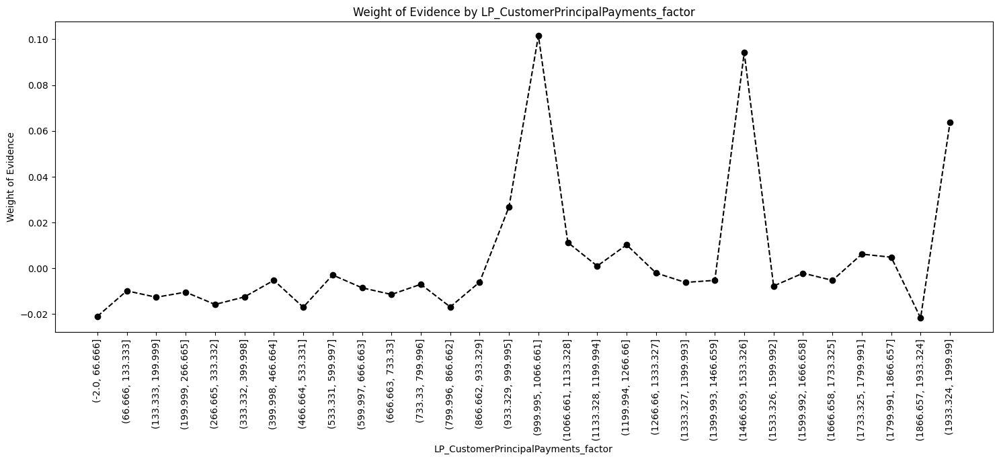

In [96]:
plot_by_woe(temp, 90)

* More than 10500
* Between 2000 and 10500
* Between 1000 and 2000
* Less than 200

In [97]:
# Create categorie
df_new['LP_CustomerPrincipalPayments_factor'] = np.where(df_new['LP_CustomerPrincipalPayments'] < 200, "<200",
                                                    np.where(df_new['LP_CustomerPrincipalPayments'] < 1000, "200_1k",
                                                    np.where(df_new['LP_CustomerPrincipalPayments'] < 2000, "1k_2k",
                                                    np.where(df_new['LP_CustomerPrincipalPayments'] < 10500, "2k_10.5k", ">10.5k"))))
df_new['LP_CustomerPrincipalPayments_factor'].value_counts()

<ipython-input-97-b2eec7999bc9>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_new['LP_CustomerPrincipalPayments_factor'] = np.where(df_new['LP_CustomerPrincipalPayments'] < 200, "<200",


,count
LP_CustomerPrincipalPayments_factor,
2k_10.5k,44584
200_1k,29013
1k_2k,19631
<200,14249
>10.5k,6452


#### **ProsperRating (Alpha)**

In [98]:
df_new['ProsperRating_factor'] = df_new['ProsperRating (Alpha)'].map(lambda x: str(x))
print(df_new['ProsperRating_factor'].dtype)
df_new['ProsperRating_factor'].value_counts()

object


<ipython-input-98-ef8656952b30>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_new['ProsperRating_factor'] = df_new['ProsperRating (Alpha)'].map(lambda x: str(x))


,count
ProsperRating_factor,
7,29076
3,18345
2,15581
0,14551
4,14274
5,9795
6,6935
1,5372


#### **LoanOriginalAmount**

In [99]:
df_new['LoanOriginalAmount_factor'] = pd.cut(df_new['LoanOriginalAmount'], 50)

temp = woe_continuous(df_new, 'LoanOriginalAmount_factor', target)

temp

<ipython-input-99-aaba26d2d708>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_new['LoanOriginalAmount_factor'] = pd.cut(df_new['LoanOriginalAmount'], 50)
<ipython-input-90-40f0a3dc61c1>:4: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df = pd.concat([df.groupby(df.columns.values[0], as_index = False)[df.columns.values[1]].count(),
<ipython-input-90-40f0a3dc61c1>:5: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt

,LoanOriginalAmount_factor,n_obs,prop_good,prop_n_obs,n_good,n_bad,prop_n_good,prop_n_bad,WoE,diff_prop_good,diff_WoE,IV
0,"(966.0, 1680.0]",5975,2.016736,0.052445,12050.0,-6075.0,0.040906,0.033629,0.195888,NaN,NaN,0.003811
1,"(1680.0, 2360.0]",7167,2.373378,0.062908,17010.0,-9843.0,0.057744,0.054488,0.058047,0.356642,1.378418e-01,0.003811
2,"(2360.0, 3040.0]",10767,2.339556,0.094506,25190.0,-14423.0,0.085513,0.079841,0.068629,0.033822,1.058207e-02,0.003811
3,"(3040.0, 3720.0]",3744,2.351763,0.032863,8805.0,-5061.0,0.029891,0.028016,0.064761,0.012207,3.867286e-03,0.003811
4,"(3720.0, 4400.0]",15156,2.734824,0.133030,41449.0,-26293.0,0.140708,0.145550,-0.033833,0.383062,9.859464e-02,0.003811
5,"(4400.0, 5080.0]",9048,2.378205,0.079418,21518.0,-12470.0,0.073048,0.069030,0.056570,0.356619,9.040302e-02,0.003811
6,"(5080.0, 5760.0]",1429,2.427572,0.012543,3469.0,-2040.0,0.011776,0.011293,0.041922,0.049367,1.464747e-02,0.003811
7,"(5760.0, 6440.0]",3593,2.443919,0.031537,8781.0,-5188.0,0.029809,0.028719,0.037248,0.016347,4.674530e-03,0.003811
8,"(6440.0, 7120.0]",4599,2.541639,0.040367,11689.0,-7090.0,0.039681,0.039248,0.010969,0.097721,2.627914e-02,0.003811
9,"(7120.0, 7800.0]",3455,2.337482,0.030326,8076.0,-4621.0,0.027416,0.025580,0.069291,0.204158,5.832268e-02,0.003811


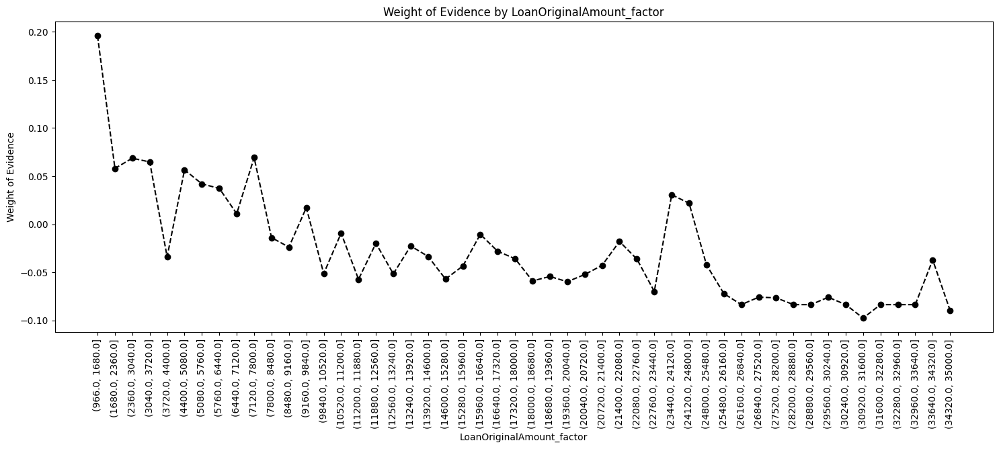

In [100]:
plot_by_woe(temp, 90)

In [101]:
temp = df_new[df_new['LoanOriginalAmount'] <= 9500]

temp['LoanOriginalAmount_factor'] = pd.cut(temp['LoanOriginalAmount'], 50)

temp = woe_continuous(temp, 'LoanOriginalAmount_factor', target)

temp

<ipython-input-101-40ec6fbc36f1>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp['LoanOriginalAmount_factor'] = pd.cut(temp['LoanOriginalAmount'], 50)
<ipython-input-90-40f0a3dc61c1>:4: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df = pd.concat([df.groupby(df.columns.values[0], as_index = False)[df.columns.values[1]].count(),
<ipython-input-90-40f0a3dc61c1>:5: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt th

,LoanOriginalAmount_factor,n_obs,prop_good,prop_n_obs,n_good,n_bad,prop_n_good,prop_n_bad,WoE,diff_prop_good,diff_WoE,IV
0,"(991.5, 1170.0]",3444,2.013066,0.048206,6933.0,-3489.0,0.039542,0.033584,0.163317,NaN,NaN,0.003888
1,"(1170.0, 1340.0]",642,2.052960,0.008986,1318.0,-676.0,0.007517,0.006507,0.144318,0.039893,0.019000,0.003888
2,"(1340.0, 1510.0]",1664,2.005409,0.023291,3337.0,-1673.0,0.019032,0.016104,0.167094,0.047551,0.022776,0.003888
3,"(1510.0, 1680.0]",225,2.053333,0.003149,462.0,-237.0,0.002635,0.002281,0.144145,0.047925,0.022949,0.003888
4,"(1680.0, 1850.0]",394,2.035533,0.005515,802.0,-408.0,0.004574,0.003927,0.152481,0.017800,0.008337,0.003888
5,"(1850.0, 2020.0]",6171,2.411441,0.086375,14881.0,-8710.0,0.084872,0.083839,0.012253,0.375908,0.140228,0.003888
6,"(2020.0, 2190.0]",199,2.140704,0.002785,426.0,-227.0,0.002430,0.002185,0.106129,0.270737,0.093876,0.003888
7,"(2190.0, 2360.0]",403,2.235732,0.005641,901.0,-498.0,0.005139,0.004794,0.069545,0.095028,0.036584,0.003888
8,"(2360.0, 2530.0]",3172,2.312736,0.044398,7336.0,-4164.0,0.041840,0.040081,0.042958,0.077004,0.026588,0.003888
9,"(2530.0, 2700.0]",922,2.193059,0.012905,2022.0,-1100.0,0.011532,0.010588,0.085417,0.119678,0.042459,0.003888


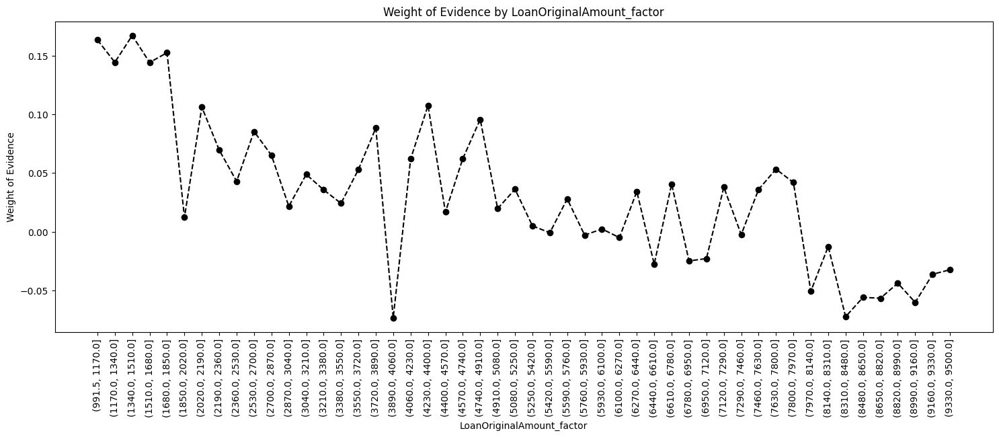

In [102]:
plot_by_woe(temp, 90)

* < 2000
* 2000 < x < 3000
* 3000 < x < 3500
* 3500 < x < 4000
* 4000 < x < 5000
* 5000 < x < 7500
* 7500 < x < 9500
* 9500 < x < 14500
* 14500 < x < 19500
* 19500 < x < 25000

In [103]:
def convert(x):
    if x <= 2000:
        return "<2k"
    elif x <= 3000:
        return "2k_3k"
    elif x <= 3500:
        return "3k_3.5k"
    elif x <= 4000:
        return "3.5k_4K"
    elif x <=5000:
        return "4k_5k"
    elif x <= 7500:
        return "5k_7.5k"
    elif x <= 9500:
        return "7.5k_9.5k"
    elif x <= 14500:
        return "9.5k_14.5k"
    elif x <= 19500:
        return "14.5k_19.5k"
    elif x <= 25000:
        return "19.5k_24.5k"
    else:
        return "25.5k<"

In [104]:
df_new['LoanOriginalAmount_factor'] = data['LoanOriginalAmount'].map(lambda x : convert(x))
df_new['LoanOriginalAmount_factor'].value_counts()

<ipython-input-104-576a3b2c5468>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_new['LoanOriginalAmount_factor'] = data['LoanOriginalAmount'].map(lambda x : convert(x))


,count
LoanOriginalAmount_factor,
9.5k_14.5k,19027
3.5k_4K,15105
14.5k_19.5k,14841
5k_7.5k,12957
<2k,12536
2k_3k,11022
4k_5k,9425
19.5k_24.5k,7937
7.5k_9.5k,6670


#### **LoanCurrentDaysDelinquent**

In [105]:
temp = df_new[df_new['LoanCurrentDaysDelinquent'] < 50]

temp['LoanCurrentDaysDelinquent_factor'] = pd.cut(temp['LoanCurrentDaysDelinquent'], 50)

temp = woe_continuous(temp, 'LoanCurrentDaysDelinquent_factor', target)

temp

<ipython-input-105-e6639d25cd9f>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp['LoanCurrentDaysDelinquent_factor'] = pd.cut(temp['LoanCurrentDaysDelinquent'], 50)
<ipython-input-90-40f0a3dc61c1>:4: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df = pd.concat([df.groupby(df.columns.values[0], as_index = False)[df.columns.values[1]].count(),
<ipython-input-90-40f0a3dc61c1>:5: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=Tr

,LoanCurrentDaysDelinquent_factor,n_obs,prop_good,prop_n_obs,n_good,n_bad,prop_n_good,prop_n_bad,WoE,diff_prop_good,diff_WoE,IV
0,"(-0.049, 0.98]",94853,2.602838,0.986357,246887.0,-152034.0,0.966388,0.954334,0.012552,NaN,NaN,0.003861
1,"(0.98, 1.96]",48,5.958333,0.000499,286.0,-238.0,0.001119,0.001494,-0.288554,3.355495,3.011054e-01,0.003861
2,"(1.96, 2.94]",40,6.000000,0.000416,240.0,-200.0,0.000939,0.001255,-0.289953,0.041667,1.399580e-03,0.003861
3,"(2.94, 3.92]",59,5.966102,0.000614,352.0,-293.0,0.001378,0.001839,-0.288816,0.033898,1.137010e-03,0.003861
4,"(3.92, 4.9]",77,6.000000,0.000801,462.0,-385.0,0.001808,0.002417,-0.289953,0.033898,1.137010e-03,0.003861
5,"(4.9, 5.88]",60,6.000000,0.000624,360.0,-300.0,0.001409,0.001883,-0.289953,0.000000,0.000000e+00,0.003861
6,"(5.88, 6.86]",51,6.000000,0.000530,306.0,-255.0,0.001198,0.001601,-0.289953,0.000000,0.000000e+00,0.003861
7,"(6.86, 7.84]",27,6.000000,0.000281,162.0,-135.0,0.000634,0.000847,-0.289953,0.000000,0.000000e+00,0.003861
8,"(7.84, 8.82]",25,6.000000,0.000260,150.0,-125.0,0.000587,0.000785,-0.289953,0.000000,0.000000e+00,0.003861
9,"(8.82, 9.8]",29,6.000000,0.000302,174.0,-145.0,0.000681,0.000910,-0.289953,0.000000,0.000000e+00,0.003861


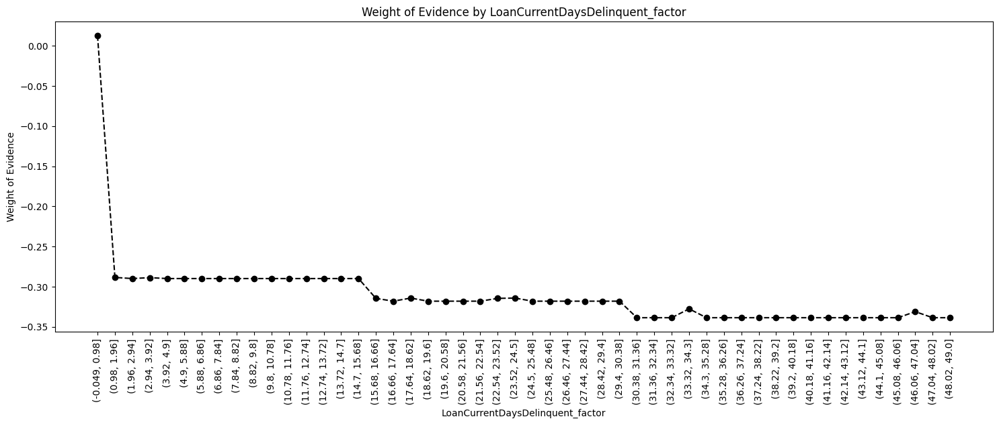

In [106]:
plot_by_woe(temp, 90)

In [107]:
def convert(x):
    if x == 0:
        return "=0"
    elif x < 50:
        return "<50"
    else:
        return "50<"

In [108]:
df_new['LoanCurrentDaysDelinquent_factor'] = df_new['LoanCurrentDaysDelinquent'].map(lambda x : convert(x))
df_new['LoanCurrentDaysDelinquent_factor'].value_counts()

<ipython-input-108-5ecfa296dcec>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_new['LoanCurrentDaysDelinquent_factor'] = df_new['LoanCurrentDaysDelinquent'].map(lambda x : convert(x))


,count
LoanCurrentDaysDelinquent_factor,
=0,94853
50<,17764
<50,1312


#### **MonthlyLoanPayment**

In [109]:
df_new['MonthlyLoanPayment_factor'] = pd.cut(df_new['MonthlyLoanPayment'], 50)

temp = woe_continuous(df_new, 'MonthlyLoanPayment_factor', target)

temp

<ipython-input-109-688b746215fd>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_new['MonthlyLoanPayment_factor'] = pd.cut(df_new['MonthlyLoanPayment'], 50)
<ipython-input-90-40f0a3dc61c1>:4: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df = pd.concat([df.groupby(df.columns.values[0], as_index = False)[df.columns.values[1]].count(),
<ipython-input-90-40f0a3dc61c1>:5: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adop

,MonthlyLoanPayment_factor,n_obs,prop_good,prop_n_obs,n_good,n_bad,prop_n_good,prop_n_bad,WoE,diff_prop_good,diff_WoE,IV
0,"(-2.252, 45.03]",4451,2.090317,0.039068,9304.0,-4853.0,0.031584,0.026865,0.161853,NaN,NaN,0.002096
1,"(45.03, 90.06]",10615,2.310787,0.093172,24529.0,-13914.0,0.083269,0.077024,0.077966,0.220470,8.388678e-02,0.002096
2,"(90.06, 135.091]",14395,2.467315,0.126351,35517.0,-21122.0,0.120570,0.116925,0.030702,0.156528,4.726426e-02,0.002096
3,"(135.091, 180.121]",19808,2.609552,0.173863,51690.0,-31882.0,0.175473,0.176489,-0.005772,0.142237,3.647355e-02,0.002096
4,"(180.121, 225.151]",8961,2.470483,0.078654,22138.0,-13177.0,0.075152,0.072944,0.029828,0.139068,3.559995e-02,0.002096
5,"(225.151, 270.181]",8608,2.632551,0.075556,22661.0,-14053.0,0.076928,0.077793,-0.011185,0.162068,4.101321e-02,0.002096
6,"(270.181, 315.211]",7761,2.647468,0.068121,20547.0,-12786.0,0.069751,0.070779,-0.014630,0.014917,3.445367e-03,0.002096
7,"(315.211, 360.242]",8939,2.673118,0.078461,23895.0,-14956.0,0.081117,0.082792,-0.020438,0.025650,5.807448e-03,0.002096
8,"(360.242, 405.272]",7805,2.823831,0.068508,22040.0,-14235.0,0.074820,0.078801,-0.051839,0.150713,3.140141e-02,0.002096
9,"(405.272, 450.302]",3948,2.752533,0.034653,10867.0,-6919.0,0.036890,0.038301,-0.037535,0.071298,1.430416e-02,0.002096


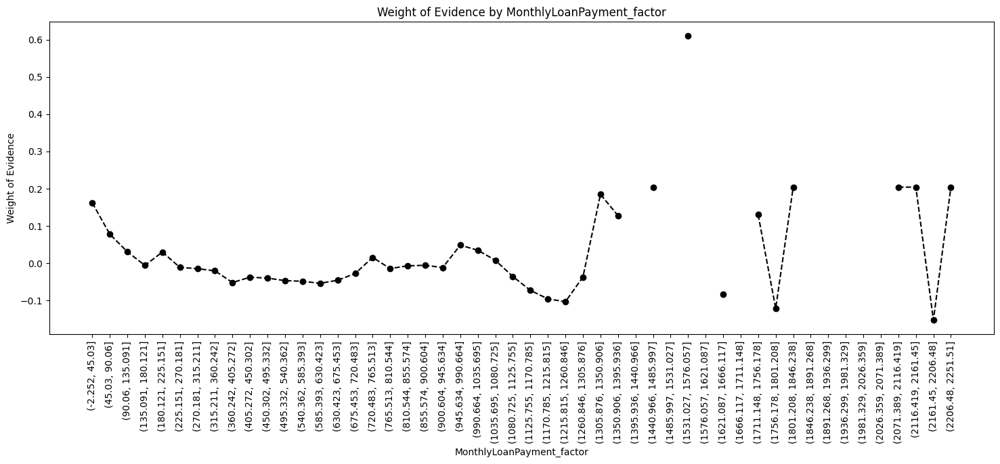

In [110]:
plot_by_woe(temp, 90)

In [111]:
temp = df_new[df_new['MonthlyLoanPayment'] > 90]

temp['MonthlyLoanPayment_factor'] = pd.cut(temp['MonthlyLoanPayment'], 50)

temp = woe_continuous(temp, 'MonthlyLoanPayment_factor', target)

temp

<ipython-input-111-396dcfe5d86b>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp['MonthlyLoanPayment_factor'] = pd.cut(temp['MonthlyLoanPayment'], 50)
<ipython-input-90-40f0a3dc61c1>:4: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df = pd.concat([df.groupby(df.columns.values[0], as_index = False)[df.columns.values[1]].count(),
<ipython-input-90-40f0a3dc61c1>:5: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt th

,MonthlyLoanPayment_factor,n_obs,prop_good,prop_n_obs,n_good,n_bad,prop_n_good,prop_n_bad,WoE,diff_prop_good,diff_WoE,IV
0,"(87.848, 133.24]",13846,2.465261,0.140028,34134.0,-20288.0,0.130888,0.125307,0.043582,NaN,NaN,0.000833
1,"(133.24, 176.47]",19568,2.612071,0.197896,51113.0,-31545.0,0.195995,0.194834,0.005942,0.146810,0.037641,0.000833
2,"(176.47, 219.7]",8823,2.466961,0.089229,21766.0,-12943.0,0.083463,0.079941,0.043112,0.145109,0.037170,0.000833
3,"(219.7, 262.93]",8163,2.601740,0.082555,21238.0,-13075.0,0.081438,0.080756,0.008408,0.134778,0.034704,0.000833
4,"(262.93, 306.16]",7674,2.674225,0.077609,20522.0,-12848.0,0.078693,0.079354,-0.008373,0.072485,0.016781,0.000833
5,"(306.16, 349.39]",8351,2.624476,0.084456,21917.0,-13566.0,0.084042,0.083789,0.003014,0.049749,0.011387,0.000833
6,"(349.39, 392.62]",7921,2.826411,0.080107,22388.0,-14467.0,0.085848,0.089354,-0.040027,0.201935,0.043041,0.000833
7,"(392.62, 435.85]",4682,2.784280,0.047350,13036.0,-8354.0,0.049987,0.051598,-0.031708,0.042131,0.008319,0.000833
8,"(435.85, 479.08]",3448,2.743329,0.034871,9459.0,-6011.0,0.036271,0.037126,-0.023306,0.040951,0.008401,0.000833
9,"(479.08, 522.31]",3890,2.771979,0.039341,10783.0,-6893.0,0.041348,0.042574,-0.029217,0.028650,0.005911,0.000833


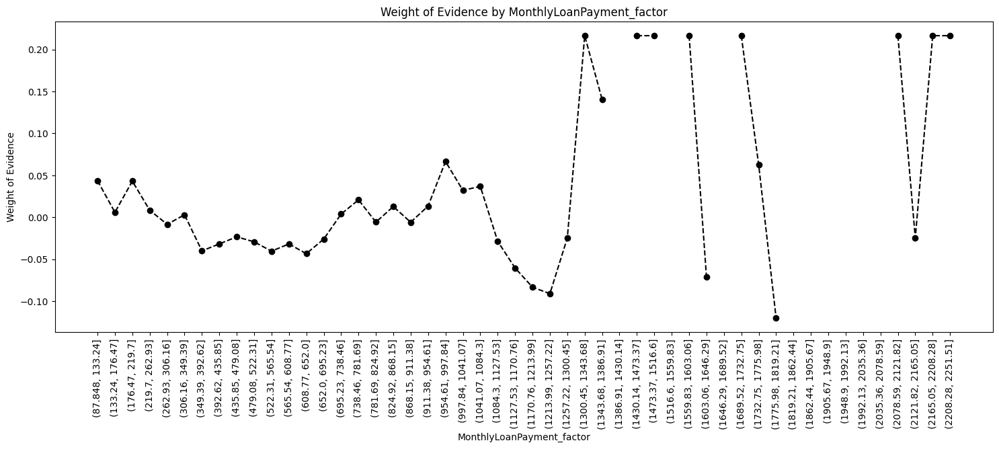

In [112]:
plot_by_woe(temp, 90)

In [113]:
def convert(x):
    if x <= 90:
        return "<90"
    elif x <= 225:
        return "90_225"
    elif x <= 360:
        return "225_360"
    elif x <= 600:
        return "360_600"
    elif x <= 750:
        return "600_750"
    else:
        return "750<"

In [114]:
df_new['MonthlyLoanPayment_factor'] = df_new['MonthlyLoanPayment'].map(lambda x : convert(x))
df_new['MonthlyLoanPayment_factor'].value_counts()

<ipython-input-114-d0fe12eb6413>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_new['MonthlyLoanPayment_factor'] = df_new['MonthlyLoanPayment'].map(lambda x : convert(x))


,count
MonthlyLoanPayment_factor,
90_225,43155
225_360,25286
360_600,23298
<90,15049
600_750,3909
750<,3232


## Analysis of Categorical Attributes

In [115]:
# WoE function for discrete unordered variables
def woe_discrete(df, discrete_variabe_name, good_bad_variable_df):
    df = pd.concat([df[discrete_variabe_name], good_bad_variable_df], axis = 1)
    df = pd.concat([df.groupby(df.columns.values[0], as_index = False)[df.columns.values[1]].count(),
                    df.groupby(df.columns.values[0], as_index = False)[df.columns.values[1]].mean()], axis = 1)
    df = df.iloc[:, [0, 1, 3]]
    df.columns = [df.columns.values[0], 'n_obs', 'prop_good']
    df['prop_n_obs'] = df['n_obs'] / df['n_obs'].sum()
    df['n_good'] = df['prop_good'] * df['n_obs']
    df['n_bad'] = (1 - df['prop_good']) * df['n_obs']
    df['prop_n_good'] = df['n_good'] / df['n_good'].sum()
    df['prop_n_bad'] = df['n_bad'] / df['n_bad'].sum()
    df['WoE'] = np.log(df['prop_n_good'] / df['prop_n_bad'])
    df = df.sort_values(['WoE'])
    df = df.reset_index(drop = True)
    df['diff_prop_good'] = df['prop_good'].diff().abs()
    df['diff_WoE'] = df['WoE'].diff().abs()
    df['IV'] = (df['prop_n_good'] - df['prop_n_bad']) * df['WoE']
    df['IV'] = df['IV'].sum()
    return df
# Here we combine all of the operations above in a function.
# The function takes 3 arguments: a dataframe, a string, and a dataframe. The function returns a dataframe as a result.

In [116]:
df_new = df_new[['LP_CustomerPrincipalPayments_factor', 'ProsperRating_factor',
       'LoanOriginalAmount_factor', 'LoanCurrentDaysDelinquent_factor',
       'MonthlyLoanPayment_factor']]
df_new.columns

Index(['LP_CustomerPrincipalPayments_factor', 'ProsperRating_factor',
       'LoanOriginalAmount_factor', 'LoanCurrentDaysDelinquent_factor',
       'MonthlyLoanPayment_factor'],
      dtype='object')

#### **LP_CustomerPrincipalPayments_factor**

In [117]:
temp = woe_discrete(df_new, 'LP_CustomerPrincipalPayments_factor', target)
temp.sort_values(by = 'LP_CustomerPrincipalPayments_factor', inplace=True)
temp

,LP_CustomerPrincipalPayments_factor,n_obs,prop_good,prop_n_obs,n_good,n_bad,prop_n_good,prop_n_bad,WoE,diff_prop_good,diff_WoE,IV
2,1k_2k,19631,2.678671,0.172309,52585.0,-32954.0,0.178511,0.182423,-0.021676,0.167983,0.034550,0.004151
1,200_1k,29013,2.846655,0.254659,82590.0,-53577.0,0.280370,0.296586,-0.056226,0.044144,0.008235,0.004151
3,2k_10.5k,44584,2.347187,0.391331,104647.0,-60063.0,0.355247,0.332490,0.066204,0.331484,0.087881,0.004151
0,<200,14249,2.890799,0.125069,41191.0,-26942.0,0.139832,0.149143,-0.064461,NaN,NaN,0.004151
4,>10.5k,6452,2.101984,0.056632,13562.0,-7110.0,0.046039,0.039359,0.156775,0.245203,0.090571,0.004151


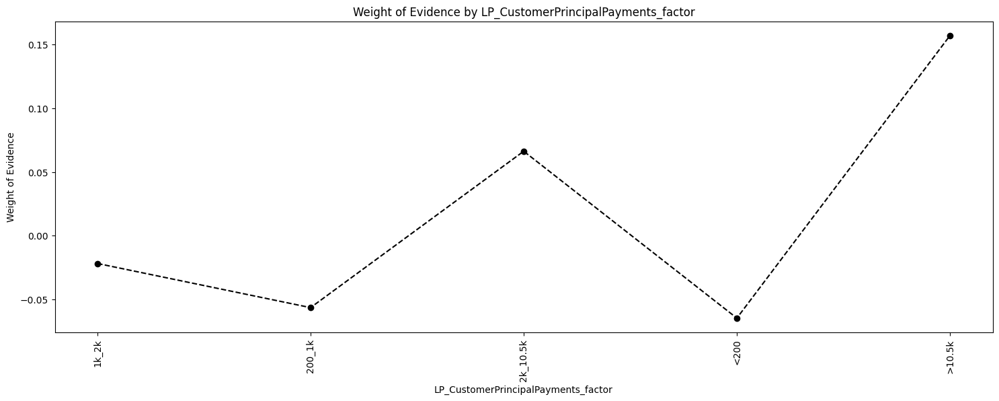

In [118]:
plot_by_woe(temp, 90)

#### **ProsperRating_factor**

In [119]:
temp = woe_discrete(df_new, 'ProsperRating_factor', target)
temp.sort_values(by = 'ProsperRating_factor', inplace=True)
temp

,ProsperRating_factor,n_obs,prop_good,prop_n_obs,n_good,n_bad,prop_n_good,prop_n_bad,WoE,diff_prop_good,diff_WoE,IV
2,0,14551,2.793691,0.127720,40651.0,-26100.0,0.137999,0.144481,-0.045906,0.055548,0.010810,0.007839
4,1,5372,2.691363,0.047152,14458.0,-9086.0,0.049081,0.050297,-0.024481,0.026350,0.005716,0.007839
1,2,15581,2.849239,0.136761,44394.0,-28813.0,0.150705,0.159500,-0.056717,0.041139,0.007667,0.007839
0,3,18345,2.890379,0.161021,53024.0,-34679.0,0.180002,0.191972,-0.064384,NaN,NaN,0.007839
5,4,14274,2.678717,0.125289,38236.0,-23962.0,0.129801,0.132646,-0.021686,0.012646,0.002795,0.007839
3,5,9795,2.717713,0.085975,26620.0,-16825.0,0.090367,0.093138,-0.030197,0.075978,0.015709,0.007839
6,6,6935,2.549676,0.060871,17682.0,-10747.0,0.060025,0.059492,0.008926,0.129041,0.030612,0.007839
7,7,29076,2.046705,0.255212,59510.0,-30434.0,0.202020,0.168473,0.181590,0.502970,0.172663,0.007839


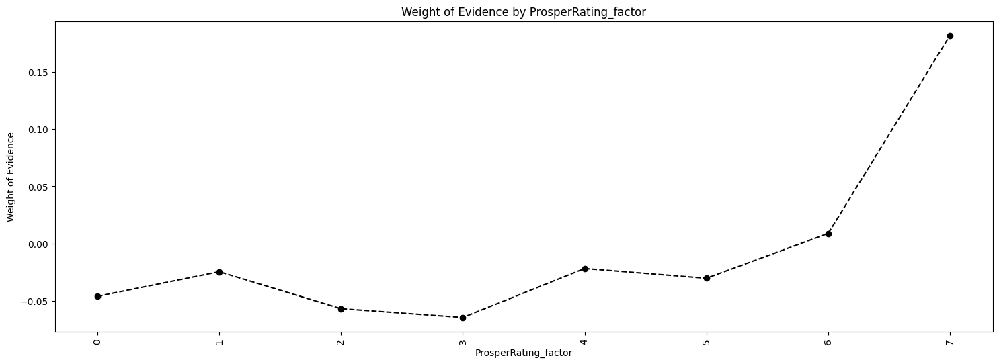

In [120]:
plot_by_woe(temp, 90)

#### **LoanOriginalAmount_factor**

In [121]:
temp = woe_discrete(df_new, 'LoanOriginalAmount_factor', target)
temp.sort_values(by = 'LoanOriginalAmount_factor', inplace=True)
temp

,LoanOriginalAmount_factor,n_obs,prop_good,prop_n_obs,n_good,n_bad,prop_n_good,prop_n_bad,WoE,diff_prop_good,diff_WoE,IV
1,14.5k_19.5k,14841,2.832289,0.130265,42034.0,-27193.0,0.142694,0.150532,-0.053475,0.179476,0.032005,0.003244
2,19.5k_24.5k,7937,2.803578,0.069666,22252.0,-14315.0,0.075539,0.079243,-0.047870,0.028711,0.005605,0.003244
0,25.5k<,680,3.011765,0.005969,2048.0,-1368.0,0.006952,0.007573,-0.085480,NaN,NaN,0.003244
9,2k_3k,11022,2.334876,0.096744,25735.0,-14713.0,0.087363,0.081447,0.070126,0.012402,0.003950,0.003244
4,3.5k_4K,15105,2.739159,0.132583,41375.0,-26270.0,0.140457,0.145423,-0.034745,0.041468,0.008538,0.003244
8,3k_3.5k,3729,2.347278,0.032731,8753.0,-5024.0,0.029714,0.027811,0.066176,0.022589,0.007050,0.003244
7,4k_5k,9425,2.369867,0.082727,22336.0,-12911.0,0.075824,0.071471,0.059126,0.080160,0.023603,0.003244
6,5k_7.5k,12957,2.450027,0.113729,31745.0,-18788.0,0.107765,0.104005,0.035523,0.198549,0.050407,0.003244
5,7.5k_9.5k,6670,2.648576,0.058545,17666.0,-10996.0,0.059971,0.060870,-0.014884,0.090584,0.019861,0.003244
3,9.5k_14.5k,19027,2.780628,0.167008,52907.0,-33880.0,0.179605,0.187549,-0.043284,0.022951,0.004587,0.003244


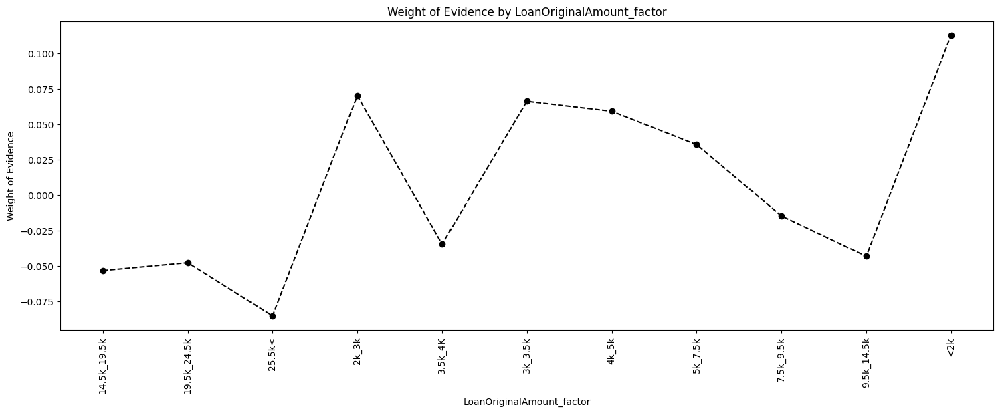

In [122]:
plot_by_woe(temp, 90)

#### **LoanCurrentDaysDelinquent_factor**

In [123]:
temp = woe_discrete(df_new, 'LoanCurrentDaysDelinquent_factor', target)
temp.sort_values(by = 'LoanCurrentDaysDelinquent_factor', inplace=True)
temp

,LoanCurrentDaysDelinquent_factor,n_obs,prop_good,prop_n_obs,n_good,n_bad,prop_n_good,prop_n_bad,WoE,diff_prop_good,diff_WoE,IV
2,50<,17764,2.201137,0.155922,39101.0,-21337.0,0.132737,0.118115,0.116711,0.401701,0.120879,0.005316
0,<50,1312,6.544970,0.011516,8587.0,-7275.0,0.029150,0.040272,-0.323189,NaN,NaN,0.005316
1,=0,94853,2.602838,0.832562,246887.0,-152034.0,0.838113,0.841613,-0.004168,3.942131,0.319021,0.005316


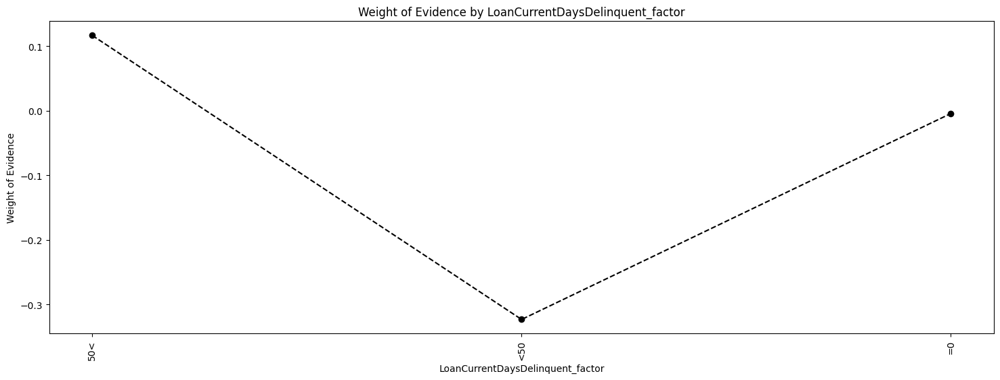

In [124]:
plot_by_woe(temp, 90)

#### **MonthlyLoanPayment_factor**

In [125]:
temp = woe_discrete(df_new, 'MonthlyLoanPayment_factor', target)
temp.sort_values(by = 'MonthlyLoanPayment_factor', inplace=True)
temp

,MonthlyLoanPayment_factor,n_obs,prop_good,prop_n_obs,n_good,n_bad,prop_n_good,prop_n_bad,WoE,diff_prop_good,diff_WoE,IV
2,225_360,25286,2.650676,0.221945,67025.0,-41739.0,0.227531,0.231054,-0.015365,0.122411,0.026391,0.001768
0,360_600,23298,2.794660,0.204496,65110.0,-41812.0,0.221030,0.231458,-0.046100,NaN,NaN,0.001768
1,600_750,3909,2.773088,0.034311,10840.0,-6931.0,0.036799,0.038368,-0.041755,0.021573,0.004344,0.001768
3,750<,3232,2.625000,0.028369,8484.0,-5252.0,0.028801,0.029073,-0.009421,0.025676,0.005943,0.001768
4,90_225,43155,2.533380,0.378789,109328.0,-66173.0,0.371138,0.366313,0.013086,0.091620,0.022507,0.001768
5,<90,15049,2.245199,0.132091,33788.0,-18739.0,0.114701,0.103733,0.100504,0.288181,0.087419,0.001768


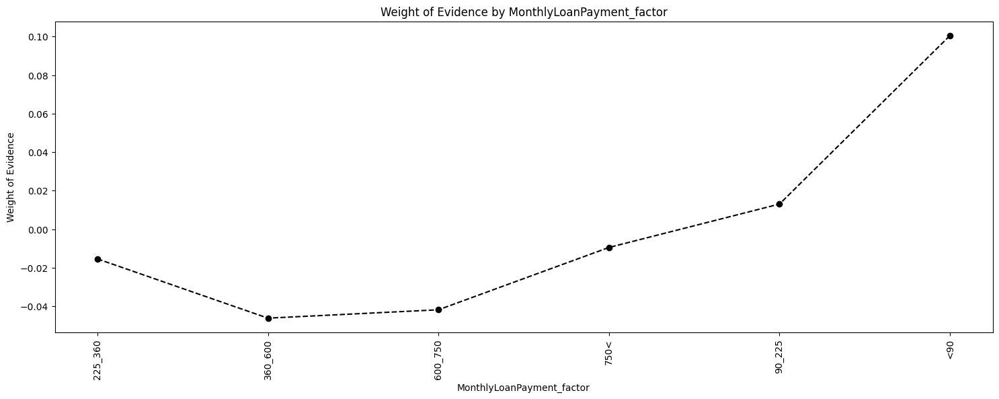

In [126]:
plot_by_woe(temp, 90)

# Algorithm (PreferredROI)

In [127]:
def PROI(df):
    # Calculate ROI
    df['InterestAmount'] = (df['LoanOriginalAmount']*(df['BorrowerRate']))
    df['TotalAmount'] = (df['InterestAmount'] + df['LoanOriginalAmount'])
    df['ROI'] = (df['InterestAmount'] / df['TotalAmount'])
    print(df['ROI'].describe())

    # Setting PROI
    df['PROI'] = df['ROI'].median()

    for i in range(df.shape[0]):
        # Check out LP_CustomerPrinciplePayment
        if df['LP_CustomerPrincipalPayments'].iloc[i] <= 1000:
            df['PROI'].iloc[i] = df['PROI'].iloc[i] + 0.05
        elif (df['LP_CustomerPrincipalPayments'].iloc[i] > 2000) & (df['LP_CustomerPrincipalPayments'].iloc[i] <= 10500):
            df['PROI'].iloc[i] = df['PROI'].iloc[i] - 0.05
        elif (df['LP_CustomerPrincipalPayments'].iloc[i] > 10500):
            df['PROI'].iloc[i] = df['PROI'].iloc[i] - 0.1

        # Check out ProsperRating
        if df['ProsperRating (Alpha)'].iloc[i] in [2, 3]:
            df['PROI'].iloc[i] = df['PROI'].iloc[i] + 0.05
        elif df['ProsperRating (Alpha)'].iloc[i] == 6:
            df['PROI'].iloc[i] = df['PROI'].iloc[i] - 0.05

        # Check out LoanOriginalAmount
        if df['LoanOriginalAmount'].iloc[i] <= 2000:
            df['PROI'].iloc[i] = df['PROI'].iloc[i] - 0.05
        elif (df['LoanOriginalAmount'].iloc[i] > 19500) & (df['LoanOriginalAmount'].iloc[i] <= 25500):
            df['PROI'].iloc[i] = df['PROI'].iloc[i] + 0.05
        elif df['LoanOriginalAmount'].iloc[i] > 25500:
            df['PROI'].iloc[i] = df['PROI'].iloc[i] + 0.1

        # Check out LoanCurrentDaysDelinquent
        if (df['LoanCurrentDaysDelinquent'].iloc[i] >= 50):
            df['PROI'].iloc[i] = df['PROI'].iloc[i] + 0.05

        # Check out MonthlyLoanPayment
        if (df['MonthlyLoanPayment'].iloc[i] <= 90):
            df['PROI'].iloc[i] = df['PROI'].iloc[i] - 0.05
        elif (df['MonthlyLoanPayment'].iloc[i] <= 750) & (df['MonthlyLoanPayment'].iloc[i] > 360):
            df['PROI'].iloc[i] = df['PROI'].iloc[i] + 0.05

    print(df['ROI'].describe())

    return df['PROI']

In [128]:
data.head()

,CreditGrade,LoanTenure,LoanStatus,BorrowerAPR,BorrowerRate,LenderYield,EstimatedEffectiveYield,EstimatedLoss,EstimatedReturn,ProsperRating (numeric),ProsperRating (Alpha),ProsperScore,ListingCategory (numeric),BorrowerState,Occupation,EmploymentStatus,EmploymentStatusDuration,IsBorrowerHomeowner,CurrentlyInGroup,CreditScoreRangeLower,CreditScoreRangeUpper,FirstRecordedCreditLine,CurrentCreditLines,OpenCreditLines,TotalCreditLinespast7years,OpenRevolvingAccounts,OpenRevolvingMonthlyPayment,InquiriesLast6Months,TotalInquiries,CurrentDelinquencies,AmountDelinquent,DelinquenciesLast7Years,PublicRecordsLast10Years,PublicRecordsLast12Months,RevolvingCreditBalance,BankcardUtilization,AvailableBankcardCredit,TotalTrades,TradesNeverDelinquent (percentage),TradesOpenedLast6Months,DebtToIncomeRatio,IncomeRange,IncomeVerifiable,StatedMonthlyIncome,LoanCurrentDaysDelinquent,LoanMonthsSinceOrigination,LoanOriginalAmount,LoanOriginationQuarter,MonthlyLoanPayment,LP_CustomerPayments,LP_CustomerPrincipalPayments,LP_InterestandFees,LP_ServiceFees,LP_CollectionFees,LP_GrossPrincipalLoss,LP_NetPrincipalLoss,LP_NonPrincipalRecoverypayments,PercentFunded,Recommendations,InvestmentFromFriendsCount,InvestmentFromFriendsAmount,Investors,EMI,ELA
0,3,36,2,0.16516,0.1580,0.1380,0.16150,0.0724,0.09170,4.0,7,6.0,0,5,36,8,2.0,1,1,640.0,659.0,8637,5.0,4.0,12.0,1,24.0,3.0,3.0,2.0,472.0,4.0,0.0,0.0,0.0,0.00,1500.0,11.0,0.81,0.0,0.17,3,1,3083.333333,0,78,9425,17,330.43,11396.14,9425.00,1971.14,-133.18,0.0,0.0,0.0,0.0,1.0,0,0,0.0,258,1496.764570,63034.0
1,7,36,3,0.12016,0.0920,0.0820,0.07960,0.0249,0.05470,6.0,0,7.0,2,5,42,0,44.0,0,0,680.0,699.0,6615,14.0,14.0,29.0,13,389.0,3.0,5.0,0.0,0.0,0.0,1.0,0.0,3989.0,0.21,10266.0,29.0,1.00,2.0,0.18,4,1,6125.000000,0,0,10000,7,318.93,0.00,0.00,0.00,0.00,0.0,0.0,0.0,0.0,1.0,0,0,0.0,1,0.000000,43120.0
2,6,36,2,0.28269,0.2750,0.2400,0.16150,0.0724,0.09170,4.0,7,6.0,0,10,36,3,67.0,0,1,480.0,499.0,8925,10.0,9.0,3.0,0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,8549.0,0.60,4100.0,22.0,0.94,0.0,0.06,6,1,2083.333333,0,86,3001,1,123.32,4186.63,3001.00,1185.63,-24.20,0.0,0.0,0.0,0.0,1.0,0,0,0.0,41,825.406311,32711.0
3,7,36,3,0.12528,0.0974,0.0874,0.08490,0.0249,0.06000,6.0,0,9.0,16,10,51,0,113.0,1,0,800.0,819.0,2245,5.0,5.0,29.0,7,115.0,0.0,1.0,4.0,10056.0,14.0,0.0,0.0,1444.0,0.04,30754.0,26.0,0.76,0.0,0.15,3,1,2875.000000,0,16,10000,31,321.45,5143.20,4091.09,1052.11,-108.01,0.0,0.0,0.0,0.0,1.0,0,0,0.0,158,413.021192,45064.0
4,7,36,3,0.24614,0.2085,0.1985,0.18316,0.0925,0.09066,3.0,4,4.0,2,23,19,0,44.0,1,0,680.0,699.0,9496,19.0,19.0,49.0,6,220.0,1.0,9.0,0.0,0.0,0.0,0.0,0.0,6193.0,0.81,695.0,39.0,0.95,2.0,0.26,2,1,9583.333333,0,6,15000,23,563.97,2819.85,1563.22,1256.63,-60.27,0.0,0.0,0.0,0.0,1.0,0,0,0.0,20,326.288414,127590.0


In [129]:
data['ELA']

,ELA
0,63034.000000
1,43120.000000
2,32711.000000
3,45064.000000
4,127590.000000
5,133260.000000
6,32290.000000
7,82684.000000
8,32644.000000
9,32644.000000


In [130]:
data['PROI'] = PROI(data)

count    113929.000000
mean          0.158354
std           0.052189
min           0.000100
25%           0.118166
50%           0.155405
75%           0.200000
max           0.332220
Name: ROI, dtype: float64


Streaming output truncated to the last 5000 lines.
See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df['PROI'].iloc[i] = df['PROI'].iloc[i] - 0.05
<ipython-input-127-ef4006f0150d>:40: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['PROI'].iloc[i] = df['PROI'].iloc[i] - 0.05
<ipython-input-127-ef4006f0150d>:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A ty

count    113929.000000
mean          0.158354
std           0.052189
min           0.000100
25%           0.118166
50%           0.155405
75%           0.200000
max           0.332220
Name: ROI, dtype: float64


In [131]:
data['PROI'].describe()

,PROI
count,113929.000000
mean,0.174348
std,0.074620
min,-0.044595
25%,0.105405
50%,0.155405
75%,0.255405
max,0.405405


In [132]:
data.head(20)

,CreditGrade,LoanTenure,LoanStatus,BorrowerAPR,BorrowerRate,LenderYield,EstimatedEffectiveYield,EstimatedLoss,EstimatedReturn,ProsperRating (numeric),ProsperRating (Alpha),ProsperScore,ListingCategory (numeric),BorrowerState,Occupation,EmploymentStatus,EmploymentStatusDuration,IsBorrowerHomeowner,CurrentlyInGroup,CreditScoreRangeLower,CreditScoreRangeUpper,FirstRecordedCreditLine,CurrentCreditLines,OpenCreditLines,TotalCreditLinespast7years,OpenRevolvingAccounts,OpenRevolvingMonthlyPayment,InquiriesLast6Months,TotalInquiries,CurrentDelinquencies,AmountDelinquent,DelinquenciesLast7Years,PublicRecordsLast10Years,PublicRecordsLast12Months,RevolvingCreditBalance,BankcardUtilization,AvailableBankcardCredit,TotalTrades,TradesNeverDelinquent (percentage),TradesOpenedLast6Months,DebtToIncomeRatio,IncomeRange,IncomeVerifiable,StatedMonthlyIncome,LoanCurrentDaysDelinquent,LoanMonthsSinceOrigination,LoanOriginalAmount,LoanOriginationQuarter,MonthlyLoanPayment,LP_CustomerPayments,LP_CustomerPrincipalPayments,LP_InterestandFees,LP_ServiceFees,LP_CollectionFees,LP_GrossPrincipalLoss,LP_NetPrincipalLoss,LP_NonPrincipalRecoverypayments,PercentFunded,Recommendations,InvestmentFromFriendsCount,InvestmentFromFriendsAmount,Investors,EMI,ELA,InterestAmount,TotalAmount,ROI,PROI
0,3,36,2,0.16516,0.1580,0.1380,0.16150,0.0724,0.09170,4.0,7,6.0,0,5,36,8,2.0,1,1,640.0,659.0,8637,5.0,4.0,12.0,1,24.0,3.0,3.0,2.0,472.0,4.0,0.0,0.0,0.0,0.00,1500.0,11.0,0.81,0.0,0.17,3,1,3083.333333,0,78,9425,17,330.43,11396.1400,9425.00,1971.1400,-133.18,0.0,0.00,0.00,0.00,1.0000,0,0,0.0,258,1496.764570,63034.0,1489.150,10914.150,0.136442,0.105405
1,7,36,3,0.12016,0.0920,0.0820,0.07960,0.0249,0.05470,6.0,0,7.0,2,5,42,0,44.0,0,0,680.0,699.0,6615,14.0,14.0,29.0,13,389.0,3.0,5.0,0.0,0.0,0.0,1.0,0.0,3989.0,0.21,10266.0,29.0,1.00,2.0,0.18,4,1,6125.000000,0,0,10000,7,318.93,0.0000,0.00,0.0000,0.00,0.0,0.00,0.00,0.00,1.0000,0,0,0.0,1,0.000000,43120.0,920.000,10920.000,0.084249,0.205405
2,6,36,2,0.28269,0.2750,0.2400,0.16150,0.0724,0.09170,4.0,7,6.0,0,10,36,3,67.0,0,1,480.0,499.0,8925,10.0,9.0,3.0,0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,8549.0,0.60,4100.0,22.0,0.94,0.0,0.06,6,1,2083.333333,0,86,3001,1,123.32,4186.6300,3001.00,1185.6300,-24.20,0.0,0.00,0.00,0.00,1.0000,0,0,0.0,41,825.406311,32711.0,825.275,3826.275,0.215686,0.105405
3,7,36,3,0.12528,0.0974,0.0874,0.08490,0.0249,0.06000,6.0,0,9.0,16,10,51,0,113.0,1,0,800.0,819.0,2245,5.0,5.0,29.0,7,115.0,0.0,1.0,4.0,10056.0,14.0,0.0,0.0,1444.0,0.04,30754.0,26.0,0.76,0.0,0.15,3,1,2875.000000,0,16,10000,31,321.45,5143.2000,4091.09,1052.1100,-108.01,0.0,0.00,0.00,0.00,1.0000,0,0,0.0,158,413.021192,45064.0,974.000,10974.000,0.088755,0.105405
4,7,36,3,0.24614,0.2085,0.1985,0.18316,0.0925,0.09066,3.0,4,4.0,2,23,19,0,44.0,1,0,680.0,699.0,9496,19.0,19.0,49.0,6,220.0,1.0,9.0,0.0,0.0,0.0,0.0,0.0,6193.0,0.81,695.0,39.0,0.95,2.0,0.26,2,1,9583.333333,0,6,15000,23,563.97,2819.8500,1563.22,1256.6300,-60.27,0.0,0.00,0.00,0.00,1.0000,0,0,0.0,20,326.288414,127590.0,3127.500,18127.500,0.172528,0.205405
5,7,60,3,0.15425,0.1314,0.1214,0.11567,0.0449,0.07077,5.0,2,10.0,1,33,42,0,82.0,1,0,740.0,759.0,495,21.0,17.0,49.0,13,1410.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,62999.0,0.39,86509.0,47.0,1.00,0.0,0.36,2,1,8333.333333,0,3,15000,32,342.37,679.3400,351.89,327.4500,-25.33,0.0,0.00,0.00,0.00,1.0000,0,0,0.0,1,46.266419,133260.0,1971.000,16971.000,0.116139,0.255405
6,7,36,3,0.31032,0.2712,0.2612,0.23820,0.1275,0.11070,2.0,5,2.0,1,16,49,0,172.0,0,0,680.0,699.0,8263,10.0,7.0,20.0,6,214.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,5812.0,0.72,1929.0,16.0,0.68,0.0,0.27,3,1,2083.333333,0,11,3000,15,122.67,1226.7000,604.25,622.4500,-22.95,0.0,0.00,0.00,0.00,1.0000,0,0,0.0,1,163.901632,32290.0,813.600,3813.600,0.213342,0.205405
7,7,36,3,0.23939,0.2019,0.1919,0.17830,0.0799,0.09840,4.0,3,4.0,2,4,27,0,103.0,0,0,700.0,719.0,7683,6.0,6.0,10.0,5,101.0,3.0,16.0,0.0,0.0,0.0,1.0,0.0,1260.0,0.13,2181.0,10.0,0.80,0.0,0.24,3,1,3355.750000,0,10,10000,15,372.60,3353.4000,1955.89,1397.5100,-69.21,0.0,0.00,0.00

## **FEATURE REDUCTION**

In [133]:
# Define X (features) and y (target)

X = data.drop(columns=['EMI', 'ELA', 'PROI'], axis = 1)
y = data[['EMI', 'ELA', 'PROI']]

In [134]:
data.shape

(113929, 68)

In [135]:
X.shape

(113929, 65)

In [136]:
y.shape

(113929, 3)

#### **1. Principal Component Analysis**

In [137]:
# Standardize the features

scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

In [138]:
# Apply PCA

pca = PCA()
X_pca = pca.fit_transform(X_scaled)

In [139]:
# Display explained variance ratio

explained_variance = pca.explained_variance_ratio_
print("Explained Variance Ratio for each component:", explained_variance)

Explained Variance Ratio for each component: [1.53457461e-01 9.09171027e-02 7.77672035e-02 6.35939981e-02
 4.15689688e-02 3.63484836e-02 3.04440649e-02 3.00216545e-02
 2.60260484e-02 2.40111232e-02 2.19885165e-02 1.96475753e-02
 1.94713409e-02 1.79580211e-02 1.73979630e-02 1.60441692e-02
 1.58975823e-02 1.52250287e-02 1.50869448e-02 1.48217889e-02
 1.46785430e-02 1.41605154e-02 1.38599058e-02 1.32174130e-02
 1.26934635e-02 1.23115405e-02 1.16105494e-02 1.12033794e-02
 1.08373957e-02 1.06592559e-02 1.00470115e-02 9.68711338e-03
 9.14579309e-03 8.79798829e-03 8.17548738e-03 7.64185045e-03
 7.22342751e-03 7.02686930e-03 6.30461148e-03 6.03927884e-03
 5.70629678e-03 5.53731552e-03 5.37566589e-03 5.00922321e-03
 3.91737914e-03 3.80808853e-03 3.62999539e-03 3.43993740e-03
 2.27710143e-03 1.80637813e-03 1.41282968e-03 1.27413605e-03
 1.00997287e-03 6.98093864e-04 6.29561991e-04 5.11649895e-04
 4.72894096e-04 2.93172088e-04 7.14268335e-05 6.34217610e-05
 3.12855502e-05 7.74202242e-06 1.8785568

In [140]:
# Choose the number of components

cumulative_variance = explained_variance.cumsum()
n_components_95 = next(i for i, total in enumerate(cumulative_variance) if total >= 0.95) + 1
print(f"Number of components to retain 95% variance: {n_components_95}")

Number of components to retain 95% variance: 40


In [141]:
# Reduce to n_components_95 dimensions

pca = PCA(n_components=n_components_95)
X_reduced_PCA = pca.fit_transform(X_scaled)

In [142]:
print("Shape of X after PCA:", X_reduced_PCA.shape)

Shape of X after PCA: (113929, 40)


Using PCA, 40 features will be selected which explains a cumulative explained variance of 95%

In [143]:
# Convert X_selected (from PCA) to a DataFrame
X_selected_pca_df = pd.DataFrame(X_reduced_PCA, columns=[f"PC_{i+1}" for i in range(X_reduced_PCA.shape[1])])

# Convert y to a DataFrame
if isinstance(y, pd.DataFrame):
    y_df = y
else:
    y_df = pd.DataFrame(y, columns=[f"Target_{i+1}" for i in range(y.shape[1])])

# Combine X_selected and y into a single DataFrame
combined_df_pca = pd.concat([X_selected_pca_df, y_df], axis=1)

In [144]:
# Save the DataFrame to a CSV file
file_name = "multi_modeling_pca.csv"
combined_df_pca.to_csv(file_name, index=False)

# Download the file to your local machine
files.download(file_name)

combined_df_pca.head()

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

,PC_1,PC_2,PC_3,PC_4,PC_5,PC_6,PC_7,PC_8,PC_9,PC_10,PC_11,PC_12,PC_13,PC_14,PC_15,PC_16,PC_17,PC_18,PC_19,PC_20,PC_21,PC_22,PC_23,PC_24,PC_25,PC_26,PC_27,PC_28,PC_29,PC_30,PC_31,PC_32,PC_33,PC_34,PC_35,PC_36,PC_37,PC_38,PC_39,PC_40,EMI,ELA,PROI
0,0.264848,-2.375961,4.737371,-1.289784,-1.597645,-0.716092,-0.455099,0.966594,-0.777869,1.691510,-1.124655,0.239325,0.090993,-0.888273,0.221069,0.336463,0.483741,-0.605286,0.024355,0.007640,0.112287,0.651800,-0.672656,-0.297846,0.019492,0.171550,-0.469343,-1.470748,1.036921,-1.173964,1.344877,-0.028122,0.423377,-0.122615,0.592142,-0.107246,-0.147897,-0.429546,-0.684228,-1.654795,1496.764570,63034.0,0.105405
1,-3.329534,-1.963003,-2.070791,1.734427,1.287354,-0.081859,0.257172,0.402567,1.629472,0.623568,-1.017204,-0.810261,0.051935,0.917917,0.483831,0.291241,-0.210610,-1.314505,0.131748,0.881273,-0.209308,-0.824899,0.473607,0.411561,0.163931,0.276209,-0.118901,0.751594,0.011933,1.090849,0.432239,-0.038646,-0.096128,-0.011336,-0.619403,-0.238048,-0.375699,-0.499301,-0.312770,-0.494449,0.000000,43120.0,0.205405
2,3.869908,-2.294166,1.496543,0.588909,-0.053028,-0.984381,0.746791,3.616560,-1.008640,-0.169295,-0.748741,-0.479374,-1.729797,-0.469320,-0.105347,-0.932535,0.191255,-1.020665,0.605860,0.605604,-0.112682,-0.571849,1.408869,0.654581,0.856744,0.737535,-0.538551,-0.774860,0.950028,0.020732,0.842702,-0.813310,0.193225,-0.637675,1.292464,-0.503933,-0.084999,0.317305,0.016442,-1.282699,825.406311,32711.0,0.105405
3,-4.133009,-2.363473,-0.671914,-1.507005,0.258205,-1.518471,-1.467166,-3.851630,-0.281209,-0.150314,0.650349,-0.780138,-0.248944,-1.602000,-0.020084,1.298643,-0.255854,-0.254369,0.652001,0.725433,1.317144,-0.382946,0.555793,-1.181597,-1.262189,0.230889,0.754051,-0.924270,0.376626,-0.749316,0.606711,0.203126,-1.226017,0.171525,-0.460800,0.283255,0.052376,-0.087459,0.117527,0.074013,413.021192,45064.0,0.105405
4,-0.684132,3.371442,-1.088429,0.480719,0.822029,-0.236891,0.607664,0.918144,1.823338,0.396344,-0.545470,0.361158,0.544003,0.209854,1.579378,-0.259356,-0.904445,0.307388,-0.587145,-0.264170,-0.259891,-0.781220,-1.652876,-0.010865,0.105109,0.247128,-0.377089,-0.677897,0.363369,-0.958800,0.325631,0.230086,-0.200241,0.340792,0.039582,-1.054751,-0.016722,0.502393,0.085913,0.124266,326.288414,127590.0,0.205405


#### **2. Feature selection using Mutual Information (with Multi-output Aggregation)**

In [145]:
# Ensure y is a NumPy array with proper shape
if not isinstance(y, np.ndarray):
    y = y.to_numpy()

# Compute mutual information for each target and aggregate scores

mi_scores = np.zeros(X_scaled.shape[1])

# y.shape[1] is the number of target variables

for i in range(y.shape[1]):
  # Compute mutual information for the i-th target variable
  mi_scores += mutual_info_regression(X_scaled, y[:, i], random_state=42)

In [146]:
mi_scores /= y.shape[1]  # Average scores across targets

In [147]:
# Select top features

percentile = 20

n_top_features = int(len(mi_scores) * percentile / 100)

In [148]:
# Get the indices of the top features

top_feature_indices = np.argsort(mi_scores)[-n_top_features:]

In [149]:
top_feature_indices

array([46,  7, 49,  8,  6, 50,  5,  3, 64,  4, 48, 62, 63])

In [150]:
# Check if X is a NumPy array or pandas DataFrame

if isinstance(X_scaled, np.ndarray):
    # If X is a NumPy array, use this indexing
    X_selected_MI = X_scaled[:, top_feature_indices]
elif isinstance(X_scaled, pd.DataFrame):
    # If X is a pandas DataFrame, use .iloc for indexing
    X_selected_MI = X_scaled.iloc[:, top_feature_indices]

In [151]:
print(f"Selected Features (indices): {top_feature_indices}")

print(f"Shape of X after feature selection: {X_selected_MI.shape}")

Selected Features (indices): [46  7 49  8  6 50  5  3 64  4 48 62 63]
Shape of X after feature selection: (113929, 13)


13 features are selected using Mutual Information with Multi-output aggregation feature selection.

In [152]:
# Convert X_selected (from Mutual Information) to a DataFrame
X_selected_MI_df = pd.DataFrame(X_selected_MI, columns=[f"PC_{i+1}" for i in range(X_selected_MI.shape[1])])

# Convert y to a DataFrame
if isinstance(y, pd.DataFrame):
    y_df = y
else:
    y_df = pd.DataFrame(y, columns=[f"Target_{i+1}" for i in range(y.shape[1])])

# Combine X_selected and y into a single DataFrame
combined_df_MI = pd.concat([X_selected_MI_df, y_df], axis=1)

In [153]:
# Save the DataFrame to a CSV file
file_name = "multi_modeling_mutl_info.csv"
combined_df_MI.to_csv(file_name, index=False)

# Download the file to your local machine
files.download(file_name)

combined_df_MI.head()

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

,PC_1,PC_2,PC_3,PC_4,PC_5,PC_6,PC_7,PC_8,PC_9,PC_10,PC_11,PC_12,PC_13,Target_1,Target_2,Target_3
0,0.174164,-0.145373,1.505678,-0.123672,-0.090143,1.553066,-0.600185,-0.668165,-0.419864,-0.464921,0.300707,0.034815,0.157519,1496.764570,63034.0,0.105405
1,0.266229,-1.318093,-0.873168,-1.530137,-1.474288,-0.763162,-1.351854,-1.228288,-1.419949,-1.347235,0.241026,-0.520337,0.158339,0.000000,43120.0,0.205405
2,-0.854399,-0.145373,0.000755,-0.123672,-0.090143,-0.025656,0.768925,0.794752,1.098553,1.099182,-0.774107,-0.612733,-0.836270,825.406311,32711.0,0.105405
3,0.266229,-1.318093,0.200431,-1.328670,-1.384715,0.242238,-1.279371,-1.164558,-1.333606,-1.275045,0.254104,-0.467665,0.165911,413.021192,45064.0,0.105405
4,1.066791,0.350873,-0.284549,-0.163205,0.275920,-0.378995,0.211885,0.339807,0.271585,0.210183,1.512680,1.632873,1.168902,326.288414,127590.0,0.205405


#### **3. Random Forest Regressor**

In [154]:
# Create a multi-output regressor to perform feature importance

# Initialize Random Forest Regressor
rf_model = RandomForestRegressor(random_state=42, n_jobs=-1)

# Fit the model to the scaled features and target variables
rf_model.fit(X_scaled, y)

# Extract feature importances for each target variable
feature_importances = np.array([tree.feature_importances_ for tree in rf_model.estimators_])

# Aggregate feature importances across all targets
average_importances = np.mean(feature_importances, axis=0)

# Sort features by importance
sorted_indices = np.argsort(average_importances)[::-1]

# Create a DataFrame for better visualization
feature_importance_df = pd.DataFrame({
    "Feature": [f"Feature_{i}" for i in range(X_scaled.shape[1])],
    "Importance": average_importances
}).sort_values(by="Importance", ascending=False)

# Display the top features
print("Top Features by Importance:")
print(feature_importance_df.head(30))

Top Features by Importance:
       Feature  Importance
62  Feature_62    0.830376
1    Feature_1    0.141041
43  Feature_43    0.024223
63  Feature_63    0.002984
48  Feature_48    0.000894
41  Feature_41    0.000177
50  Feature_50    0.000055
40  Feature_40    0.000051
49  Feature_49    0.000042
3    Feature_3    0.000025
8    Feature_8    0.000013
4    Feature_4    0.000009
51  Feature_51    0.000009
64  Feature_64    0.000008
46  Feature_46    0.000008
5    Feature_5    0.000007
7    Feature_7    0.000007
21  Feature_21    0.000006
6    Feature_6    0.000005
14  Feature_14    0.000004
52  Feature_52    0.000004
45  Feature_45    0.000003
16  Feature_16    0.000003
37  Feature_37    0.000003
27  Feature_27    0.000003
61  Feature_61    0.000002
9    Feature_9    0.000002
35  Feature_35    0.000002
2    Feature_2    0.000002
44  Feature_44    0.000002


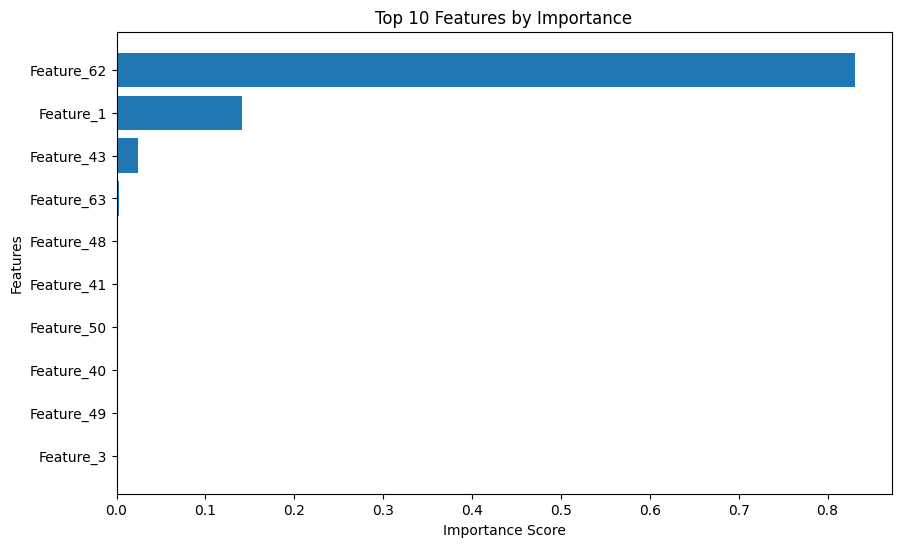

In [155]:
# Plot the feature importances
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 6))
plt.barh(feature_importance_df["Feature"][:10], feature_importance_df["Importance"][:10])
plt.xlabel("Importance Score")
plt.ylabel("Features")
plt.title("Top 10 Features by Importance")
plt.gca().invert_yaxis()
plt.show()

In [156]:
# Select the top 10 important features

top_10_indices = feature_importance_df["Feature"][:10].apply(lambda x: int(x.split('_')[1])).values
X_selected = X_scaled[:, top_10_indices]

In [157]:
# Combine the selected features with the target variables

combined_df = pd.DataFrame(X_selected, columns=[f"Feature_{i}" for i in top_10_indices])
combined_df = pd.concat([combined_df, pd.DataFrame(y, columns=["EMI", "ELA", "PROI"])], axis=1)

In [158]:
# Save to CSV

output_file = "multi_modeling_rfe.csv"
combined_df.to_csv(output_file, index=False)

combined_df.head()

,Feature_62,Feature_1,Feature_43,Feature_63,Feature_48,Feature_41,Feature_50,Feature_40,Feature_49,Feature_3,EMI,ELA,PROI
0,0.034815,-0.462857,-0.337589,0.157519,0.300707,-0.377483,1.553066,-0.191677,1.505678,-0.668165,1496.764570,63034.0,0.105405
1,-0.520337,-0.462857,0.069122,0.158339,0.241026,0.369516,-0.763162,-0.172840,-0.873168,-1.228288,0.000000,43120.0,0.205405
2,-0.612733,-0.462857,-0.471302,-0.836270,-0.774107,1.863515,-0.025656,-0.398888,0.000755,0.794752,825.406311,32711.0,0.105405
3,-0.467665,-0.462857,-0.365446,0.165911,0.254104,-0.377483,0.242238,-0.229352,0.200431,-1.164558,413.021192,45064.0,0.105405
4,1.632873,-0.462857,0.531547,1.168902,1.512680,-1.124482,-0.378995,-0.022141,-0.284549,0.339807,326.288414,127590.0,0.205405


In [159]:
# Download the file to your local machine

files.download(output_file)

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>